<a href="https://colab.research.google.com/github/seawavve/Network_wavve/blob/main/RepNet/heatmap_repnet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Copyright 2020 Google LLC.

Licensed aunder the Apache License, Version 2.0 (the "License");

In [ ]:
#@title License
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# RepNet

This colab contains a pre-trained [RepNet](https://sites.google.com/view/repnet) model. It can be used to predict the rate at which repetitions are happening in a video in a class-agnostic manner. These estimates can be used to count the number of repetitions in videos.

This model is able to count repetitions in many domains: counting the number of reps while exercising, measuring the rate of biological events like heartrates etc. 

Ensure you are running the Colab with a GPU runtime.


# Setup



In [1]:
#수정한 부분: @tf.function 주석처리
##################TEST CODE######################
import tensorflow as originTF
import numpy as np
print(originTF.__version__)
print(np.__version__)

a=originTF.constant([[[[0.1]*1]*64]*64])
#print(a)
print(a.numpy())
#originTF.executing_eagerly()

reduction = np.reshape(a, (64, -1))
print(reduction)
print(len(reduction))
print(len(reduction[0]))

2.6.0
1.19.5
[[[[0.1]
   [0.1]
   [0.1]
   ...
   [0.1]
   [0.1]
   [0.1]]

  [[0.1]
   [0.1]
   [0.1]
   ...
   [0.1]
   [0.1]
   [0.1]]

  [[0.1]
   [0.1]
   [0.1]
   ...
   [0.1]
   [0.1]
   [0.1]]

  ...

  [[0.1]
   [0.1]
   [0.1]
   ...
   [0.1]
   [0.1]
   [0.1]]

  [[0.1]
   [0.1]
   [0.1]
   ...
   [0.1]
   [0.1]
   [0.1]]

  [[0.1]
   [0.1]
   [0.1]
   ...
   [0.1]
   [0.1]
   [0.1]]]]
[[0.1 0.1 0.1 ... 0.1 0.1 0.1]
 [0.1 0.1 0.1 ... 0.1 0.1 0.1]
 [0.1 0.1 0.1 ... 0.1 0.1 0.1]
 ...
 [0.1 0.1 0.1 ... 0.1 0.1 0.1]
 [0.1 0.1 0.1 ... 0.1 0.1 0.1]
 [0.1 0.1 0.1 ... 0.1 0.1 0.1]]
64
64


In [2]:
#@title
print('################')
import base64
import io
import os
import time
import math

import cv2

from IPython.display import display
from IPython.display import HTML
from IPython.display import Javascript

import matplotlib
from matplotlib.animation import FuncAnimation
import matplotlib.pyplot as plt

import numpy as np
from PIL import Image
from scipy.signal import medfilt

import tensorflow.compat.v2 as tf
import tensorflow as originTF

! pip install youtube_dl
import youtube_dl

from google.colab import drive
from google.colab import output
from google.colab.output import eval_js

# Model definition
layers = tf.keras.layers
regularizers = tf.keras.regularizers


class ResnetPeriodEstimator(tf.keras.models.Model):
  """RepNet model."""

  def __init__(
      self,
      num_frames=64,
      image_size=112,
      base_model_layer_name='conv4_block3_out',
      temperature=13.544,
      dropout_rate=0.25,
      l2_reg_weight=1e-6,
      temporal_conv_channels=512,
      temporal_conv_kernel_size=3,
      temporal_conv_dilation_rate=3,
      conv_channels=32,
      conv_kernel_size=3,
      transformer_layers_config=((512, 4, 512),),
      transformer_dropout_rate=0.0,
      transformer_reorder_ln=True,
      period_fc_channels=(512, 512),
      within_period_fc_channels=(512, 512)):
    super(ResnetPeriodEstimator, self).__init__()

    # Model params.
    self.num_frames = num_frames
    self.image_size = image_size

    self.base_model_layer_name = base_model_layer_name

    self.temperature = temperature

    self.dropout_rate = dropout_rate
    self.l2_reg_weight = l2_reg_weight

    self.temporal_conv_channels = temporal_conv_channels
    self.temporal_conv_kernel_size = temporal_conv_kernel_size
    self.temporal_conv_dilation_rate = temporal_conv_dilation_rate

    self.conv_channels = conv_channels
    self.conv_kernel_size = conv_kernel_size
    # Transformer config in form of (channels, heads, bottleneck channels).
    self.transformer_layers_config = transformer_layers_config
    self.transformer_dropout_rate = transformer_dropout_rate
    self.transformer_reorder_ln = transformer_reorder_ln

    self.period_fc_channels = period_fc_channels
    self.within_period_fc_channels = within_period_fc_channels

    # Base ResNet50 Model.
    base_model = tf.keras.applications.ResNet50V2(
        include_top=False, weights=None, pooling='max')
    self.base_model = tf.keras.models.Model(
        inputs=base_model.input,
        outputs=base_model.get_layer(self.base_model_layer_name).output)

    # 3D Conv on k Frames
    self.temporal_conv_layers = [
        layers.Conv3D(self.temporal_conv_channels,
                      self.temporal_conv_kernel_size,
                      padding='same',
                      dilation_rate=(self.temporal_conv_dilation_rate, 1, 1),
                      kernel_regularizer=regularizers.l2(self.l2_reg_weight),
                      kernel_initializer='he_normal')]
    self.temporal_bn_layers = [layers.BatchNormalization()
                               for _ in self.temporal_conv_layers]

    # Counting Module (Self-sim > Conv > Transformer > Classifier)
    self.conv_3x3_layer = layers.Conv2D(self.conv_channels,
                                        self.conv_kernel_size,
                                        padding='same',
                                        activation=tf.nn.relu)

    channels = self.transformer_layers_config[0][0]
    self.input_projection = layers.Dense(
        channels, kernel_regularizer=regularizers.l2(self.l2_reg_weight),
        activation=None)
    self.input_projection2 = layers.Dense(
        channels, kernel_regularizer=regularizers.l2(self.l2_reg_weight),
        activation=None)

    length = self.num_frames
    self.pos_encoding = tf.compat.v1.get_variable(
        name='resnet_period_estimator/pos_encoding',
        shape=[1, length, 1],
        initializer=tf.compat.v1.truncated_normal_initializer(stddev=0.02))
    self.pos_encoding2 = tf.compat.v1.get_variable(
        name='resnet_period_estimator/pos_encoding2',
        shape=[1, length, 1],
        initializer=tf.compat.v1.truncated_normal_initializer(stddev=0.02))

    self.transformer_layers = []
    for d_model, num_heads, dff in self.transformer_layers_config:
      self.transformer_layers.append(
          TransformerLayer(d_model, num_heads, dff,
                           self.transformer_dropout_rate,
                           self.transformer_reorder_ln))

    self.transformer_layers2 = []
    for d_model, num_heads, dff in self.transformer_layers_config:
      self.transformer_layers2.append(
          TransformerLayer(d_model, num_heads, dff,
                           self.transformer_dropout_rate,
                           self.transformer_reorder_ln))

    # Period Prediction Module.
    self.dropout_layer = layers.Dropout(self.dropout_rate)
    num_preds = self.num_frames//2
    self.fc_layers = []
    for channels in self.period_fc_channels:
      self.fc_layers.append(layers.Dense(
          channels, kernel_regularizer=regularizers.l2(self.l2_reg_weight),
          activation=tf.nn.relu))
    self.fc_layers.append(layers.Dense(
        num_preds, kernel_regularizer=regularizers.l2(self.l2_reg_weight)))

    # Within Period Module
    num_preds = 1
    self.within_period_fc_layers = []
    for channels in self.within_period_fc_channels:
      self.within_period_fc_layers.append(layers.Dense(
          channels, kernel_regularizer=regularizers.l2(self.l2_reg_weight),
          activation=tf.nn.relu))
    self.within_period_fc_layers.append(layers.Dense(
        num_preds, kernel_regularizer=regularizers.l2(self.l2_reg_weight)))

  def call(self, x):
    # Ensures we are always using the right batch_size during train/eval.
    batch_size = tf.shape(x)[0]
    # Conv Feature Extractor.
    x = tf.reshape(x, [-1, self.image_size, self.image_size, 3])
    x = self.base_model(x)
    h = tf.shape(x)[1]
    w = tf.shape(x)[2]
    c = tf.shape(x)[3]
    x = tf.reshape(x, [batch_size, -1, h, w, c])

    # 3D Conv to give temporal context to per-frame embeddings. 
    for bn_layer, conv_layer in zip(self.temporal_bn_layers,
                                    self.temporal_conv_layers):
      x = conv_layer(x)
      x = bn_layer(x)
      x = tf.nn.relu(x)

    x = tf.reduce_max(x, [2, 3])

    # Reshape and prepare embs for output.
    final_embs = x
    ##################################################################################
    # Get self-similarity matrix.
    originTF.config.run_functions_eagerly(True)
    x = get_sims(x, self.temperature)
    #assert originTF.executing_eagerly(),'WHY.........'
    x_np = np.reshape(x, (-1))
    print(len(x_np))
    x_np = np.reshape(x_np,(64,-1))
    new_np=np.array(x_np)

    #엣지케이스 지우기
    for i in range(5):
      for j in range(5):
        new_np[i][j]=4.5598671e-04
    for i in range(60,64):
      for j in range(60,64):
        new_np[i][j]=4.5598671e-04
    
    plt.imshow(new_np, cmap='hot', interpolation='nearest')
    plt.show()
    print(new_np)

    print(originTF.executing_eagerly())
    #print(x.numpy())

    # reduction = np.squeeze(x.numpy(), axis=1)
    # print(reduction)
    print('batch_size: ',batch_size)
    print('num_frames: ',self.num_frames)
    print('len(x_np)/batch_size:',len(x_np)/batch_size)



    # 3x3 conv layer on self-similarity matrix.
    x = self.conv_3x3_layer(x)
    x = tf.reshape(x, [batch_size, self.num_frames, -1])
    within_period_x = x

    # Period prediction.
    x = self.input_projection(x)
    x += self.pos_encoding
    for transformer_layer in self.transformer_layers:
      x = transformer_layer(x)
    x = flatten_sequential_feats(x, batch_size, self.num_frames)
    for fc_layer in self.fc_layers:
      x = self.dropout_layer(x)
      x = fc_layer(x)

    # Within period prediction.
    within_period_x = self.input_projection2(within_period_x)
    within_period_x += self.pos_encoding2
    for transformer_layer in self.transformer_layers2:
      within_period_x = transformer_layer(within_period_x)
    within_period_x = flatten_sequential_feats(within_period_x,
                                               batch_size,
                                               self.num_frames)
    for fc_layer in self.within_period_fc_layers:
      within_period_x = self.dropout_layer(within_period_x)
      within_period_x = fc_layer(within_period_x)

    return x, within_period_x, final_embs

#  @tf.function
  def preprocess(self, imgs):
    imgs = tf.cast(imgs, tf.float32)
    imgs -= 127.5
    imgs /= 127.5
    imgs = tf.image.resize(imgs, (self.image_size, self.image_size))
    return imgs


def get_sims(embs, temperature):
  """Calculates self-similarity between batch of sequence of embeddings."""
  batch_size = tf.shape(embs)[0]
  seq_len = tf.shape(embs)[1]
  embs = tf.reshape(embs, [batch_size, seq_len, -1])

  def _get_sims(embs):
    """Calculates self-similarity between sequence of embeddings."""
    dist = pairwise_l2_distance(embs, embs)
    sims = -1.0 * dist
    return sims

  sims = tf.map_fn(_get_sims, embs)
  sims /= temperature
  sims = tf.nn.softmax(sims, axis=-1)
  sims = tf.expand_dims(sims, -1)
  return sims


def flatten_sequential_feats(x, batch_size, seq_len):
  """Flattens sequential features with known batch size and seq_len."""
  x = tf.reshape(x, [batch_size, seq_len, -1])
  return x


# Transformer from https://www.tensorflow.org/tutorials/text/transformer .
def scaled_dot_product_attention(q, k, v, mask):
  """Calculate the attention weights.

  q, k, v must have matching leading dimensions.
  k, v must have matching penultimate dimension, i.e.: seq_len_k = seq_len_v.
  The mask has different shapes depending on its type(padding or look ahead)
  but it must be broadcastable for addition.

  Args:
    q: query shape == (..., seq_len_q, depth)
    k: key shape == (..., seq_len_k, depth)
    v: value shape == (..., seq_len_v, depth_v)
    mask: Float tensor with shape broadcastable
          to (..., seq_len_q, seq_len_k). Defaults to None.

  Returns:
    outputs: shape == (..., seq_len_q, depth_v)
    attention_weights: shape == (..., seq_len_q, seq_len_k)
  """

  matmul_qk = tf.matmul(q, k, transpose_b=True)  # (..., seq_len_q, seq_len_k)

  # scale matmul_qk.
  dk = tf.cast(tf.shape(k)[-1], tf.float32)
  scaled_attention_logits = matmul_qk / tf.math.sqrt(dk)

  # add the mask to the scaled tensor.
  if mask is not None:
    scaled_attention_logits += (mask * -1e9)

  # softmax is normalized on the last axis (seq_len_k) so that the scores
  # add up to 1.
  # (..., seq_len_q, seq_len_k)
  attention_weights = tf.nn.softmax(scaled_attention_logits, axis=-1)

  outputs = tf.matmul(attention_weights, v)  # (..., seq_len_q, depth_v)

  return outputs, attention_weights


def point_wise_feed_forward_network(d_model, dff):
  return tf.keras.Sequential([
      tf.keras.layers.Dense(dff, activation='relu'),
      tf.keras.layers.Dense(d_model)
  ])


class MultiHeadAttention(tf.keras.layers.Layer):
  """Multi-headed attention layer."""

  def __init__(self, d_model, num_heads):
    super(MultiHeadAttention, self).__init__()
    self.num_heads = num_heads
    self.d_model = d_model

    assert d_model % self.num_heads == 0

    self.depth = d_model // self.num_heads

    self.wq = tf.keras.layers.Dense(d_model)
    self.wk = tf.keras.layers.Dense(d_model)
    self.wv = tf.keras.layers.Dense(d_model)

    self.dense = tf.keras.layers.Dense(d_model)

  def split_heads(self, x, batch_size):
    """Split the last dimension into (num_heads, depth)."""
    x = tf.reshape(x, (batch_size, -1, self.num_heads, self.depth))
    return tf.transpose(x, perm=[0, 2, 1, 3])

  def call(self, v, k, q, mask):
    batch_size = tf.shape(q)[0]

    q = self.wq(q)  # (batch_size, seq_len, d_model)
    k = self.wk(k)  # (batch_size, seq_len, d_model)
    v = self.wv(v)  # (batch_size, seq_len, d_model)

    q = self.split_heads(
        q, batch_size)  # (batch_size, num_heads, seq_len_q, depth)
    k = self.split_heads(
        k, batch_size)  # (batch_size, num_heads, seq_len_k, depth)
    v = self.split_heads(
        v, batch_size)  # (batch_size, num_heads, seq_len_v, depth)

    # scaled_attention.shape == (batch_size, num_heads, seq_len_q, depth)
    # attention_weights.shape == (batch_size, num_heads, seq_len_q, seq_len_k)
    scaled_attention, attention_weights = scaled_dot_product_attention(
        q, k, v, mask)

    scaled_attention = tf.transpose(
        scaled_attention,
        perm=[0, 2, 1, 3])  # (batch_size, seq_len_q, num_heads, depth)

    concat_attention = tf.reshape(
        scaled_attention,
        (batch_size, -1, self.d_model))  # (batch_size, seq_len_q, d_model)

    outputs = self.dense(concat_attention)  # (batch_size, seq_len_q, d_model)

    return outputs, attention_weights


class TransformerLayer(tf.keras.layers.Layer):
  """Implements a single transformer layer (https://arxiv.org/abs/1706.03762).
  """

  def __init__(self, d_model, num_heads, dff,
               dropout_rate=0.1,
               reorder_ln=False):
    super(TransformerLayer, self).__init__()

    self.mha = MultiHeadAttention(d_model, num_heads)
    self.ffn = point_wise_feed_forward_network(d_model, dff)

    self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)

    self.dropout1 = tf.keras.layers.Dropout(dropout_rate)
    self.dropout2 = tf.keras.layers.Dropout(dropout_rate)

    self.reorder_ln = reorder_ln

  def call(self, x):
    inp_x = x

    if self.reorder_ln:
      x = self.layernorm1(x)

    # (batch_size, input_seq_len, d_model)
    attn_output, _ = self.mha(x, x, x, mask=None)
    attn_output = self.dropout1(attn_output)

    if self.reorder_ln:
      out1 = inp_x + attn_output
      x = out1
    else:
      # (batch_size, input_seq_len, d_model)
      out1 = self.layernorm1(x + attn_output)
      x = out1

    if self.reorder_ln:
      x = self.layernorm2(x)

    # (batch_size, input_seq_len, d_model)
    ffn_output = self.ffn(x)
    ffn_output = self.dropout2(ffn_output)

    if self.reorder_ln:
      out2 = out1 + ffn_output
    else:
      # (batch_size, input_seq_len, d_model)
      out2 = self.layernorm2(out1 + ffn_output)

    return out2


def pairwise_l2_distance(a, b):
  """Computes pairwise distances between all rows of a and all rows of b."""
  norm_a = tf.reduce_sum(tf.square(a), 1)
  norm_a = tf.reshape(norm_a, [-1, 1])
  norm_b = tf.reduce_sum(tf.square(b), 1)
  norm_b = tf.reshape(norm_b, [1, -1])
  dist = tf.maximum(norm_a - 2.0 * tf.matmul(a, b, False, True) + norm_b, 0.0)
  return dist


def get_repnet_model(logdir):
  """Returns a trained RepNet model.

  Args:
    logdir (string): Path to directory where checkpoint will be downloaded.

  Returns:
    model (Keras model): Trained RepNet model.
  """
  # Check if we are in eager mode.
  assert tf.executing_eagerly()

  # Models will be called in eval mode.
  tf.keras.backend.set_learning_phase(0)

  # Define RepNet model.
  model = ResnetPeriodEstimator()
  # tf.function for speed.
  #model.call = tf.function(model.call)

  # Define checkpoint and checkpoint manager.
  ckpt = tf.train.Checkpoint(model=model)
  ckpt_manager = tf.train.CheckpointManager(
      ckpt, directory=logdir, max_to_keep=10)
  latest_ckpt = ckpt_manager.latest_checkpoint
  print('Loading from: ', latest_ckpt)
  if not latest_ckpt:
    raise ValueError('Path does not have a checkpoint to load.')
  # Restore weights.
  ckpt.restore(latest_ckpt).expect_partial()

  # Pass dummy frames to build graph.
  model(tf.random.uniform((1, 64, 112, 112, 3)))
  return model


def unnorm(query_frame):
  min_v = query_frame.min()
  max_v = query_frame.max()
  query_frame = (query_frame - min_v) / max(1e-7, (max_v - min_v))
  return query_frame


def create_count_video(frames,
                       per_frame_counts,
                       within_period,
                       score,
                       fps,
                       output_file,
                       delay,
                       plot_count=True,
                       plot_within_period=False,
                       plot_score=False):
  """Creates video with running count and within period predictions.

  Args:
    frames (List): List of images in form of NumPy arrays.
    per_frame_counts (List): List of floats indicating repetition count for
      each frame. This is the rate of repetition for that particular frame.
      Summing this list up gives count over entire video.
    within_period (List): List of floats indicating score between 0 and 1 if the
      frame is inside the periodic/repeating portion of a video or not.
    score (float): Score between 0 and 1 indicating the confidence of the
      RepNet model's count predictions.
    fps (int): Frames per second of the input video. Used to scale the
      repetition rate predictions to Hz.
    output_file (string): Path of the output video.
    delay (integer): Delay between each frame in the output video.
    plot_count (boolean): if True plots the count in the output video.
    plot_within_period (boolean): if True plots the per-frame within period
      scores.
    plot_score (boolean): if True plots the confidence of the model along with
      count ot within_period scores.
  """
  if output_file[-4:] not in ['.mp4', '.gif']:
    raise ValueError('Output format can only be mp4 or gif')
  num_frames = len(frames)

  running_counts = np.cumsum(per_frame_counts)
  final_count = running_counts[-1]

  def count(idx):
    return int(np.round(running_counts[idx]))

  def rate(idx):
    return per_frame_counts[idx] * fps

  if plot_count and not plot_within_period:
    fig = plt.figure(figsize=(10, 12), tight_layout=True)
    im = plt.imshow(unnorm(frames[0]))
    if plot_score:
      plt.suptitle('Pred Count: %d, '
                   'Prob: %0.1f' % (int(np.around(final_count)), score),
                   fontsize=24)

    plt.title('Count 0, Rate: 0', fontsize=24)
    plt.axis('off')
    plt.grid(b=None)
    def update_count_plot(i):
      """Updates the count plot."""
      im.set_data(unnorm(frames[i]))
      plt.title('Count %d, Rate: %0.4f Hz' % (count(i), rate(i)), fontsize=24)

    anim = FuncAnimation(
        fig,
        update_count_plot,
        frames=np.arange(1, num_frames),
        interval=delay,
        blit=False)
    if output_file[-3:] == 'mp4':
      anim.save(output_file, dpi=100, fps=24)
    elif output_file[-3:] == 'gif':
      anim.save(output_file, writer='imagemagick', fps=24, dpi=100)

  elif plot_within_period:
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))
    im = axs[0].imshow(unnorm(frames[0]))
    axs[1].plot(0, within_period[0])
    axs[1].set_xlim((0, len(frames)))
    axs[1].set_ylim((0, 1))

    if plot_score:
      plt.suptitle('Pred Count: %d, '
                   'Prob: %0.1f' % (int(np.around(final_count)), score),
                   fontsize=24)

    if plot_count:
      axs[0].set_title('Count 0, Rate: 0', fontsize=20)

    plt.axis('off')
    plt.grid(b=None)

    def update_within_period_plot(i):
      """Updates the within period plot along with count."""
      im.set_data(unnorm(frames[i]))
      axs[0].set_xticks([])
      axs[0].set_yticks([])
      xs = []
      ys = []
      if plot_count:
        axs[0].set_title('Count %d, Rate: %0.4f Hz' % (count(i), rate(i)),
                         fontsize=20)
      for idx in range(i):
        xs.append(idx)
        ys.append(within_period[int(idx * len(within_period) / num_frames)])
      axs[1].clear()
      axs[1].set_title('Within Period or Not', fontsize=20)
      axs[1].set_xlim((0, num_frames))
      axs[1].set_ylim((-0.05, 1.05))
      axs[1].plot(xs, ys)

    anim = FuncAnimation(
        fig,
        update_within_period_plot,
        frames=np.arange(1, num_frames),
        interval=delay,
        blit=False,
    )
    if output_file[-3:] == 'mp4':
      anim.save(output_file, dpi=100, fps=24)
    elif output_file[-3:] == 'gif':
      anim.save(output_file, writer='imagemagick', fps=24, dpi=100)

  plt.close()


def show_video(video_path):
  mp4 = open(video_path, 'rb').read()
  data_url = 'data:video/mp4;base64,' + base64.b64encode(mp4).decode()
  return HTML("""<video width=600 controls>
      <source src="%s" type="video/mp4"></video>
  """ % data_url)


def viz_reps(frames,
             count,
             score,
             alpha=1.0,
             pichart=True,
             colormap=plt.cm.PuBu,
             num_frames=None,
             interval=30,
             plot_score=True):
  """Visualize repetitions."""
  if isinstance(count, list):
    counts = len(frames) * [count/len(frames)]
  else:
    counts = count
  sum_counts = np.cumsum(counts)
  tmp_path = '/tmp/output.mp4'
  fig, ax = plt.subplots(ncols=1, nrows=1, figsize=(5, 5),
                         tight_layout=True,)

  h, w, _ = np.shape(frames[0])
  wedge_x = 95 / 112 * w
  wedge_y = 17 / 112 * h
  wedge_r = 15 / 112 * h
  txt_x = 95 / 112 * w
  txt_y = 19 / 112 * h
  otxt_size = 62 / 112 * h

  if plot_score:
    plt.title('Score:%.2f' % score, fontsize=20)
  im0 = ax.imshow(unnorm(frames[0]))

  if not num_frames:
    num_frames = len(frames)

  if pichart:
    wedge1 = matplotlib.patches.Wedge(
        center=(wedge_x, wedge_y),
        r=wedge_r,
        theta1=0,
        theta2=0,
        color=colormap(1.),
        alpha=alpha)
    wedge2 = matplotlib.patches.Wedge(
        center=(wedge_x, wedge_y),
        r=wedge_r,
        theta1=0,
        theta2=0,
        color=colormap(0.5),
        alpha=alpha)

    ax.add_patch(wedge1)
    ax.add_patch(wedge2)
    txt = ax.text(
        txt_x,
        txt_y,
        '0',
        size=35,
        ha='center',
        va='center',
        alpha=0.9,
        color='white',
    )

  else:
    txt = ax.text(
        txt_x,
        txt_y,
        '0',
        size=otxt_size,
        ha='center',
        va='center',
        alpha=0.8,
        color=colormap(0.4),
    )

  def update(i):
    """Update plot with next frame."""
    im0.set_data(unnorm(frames[i]))
    ctr = int(sum_counts[i])
    if pichart:
      if ctr%2 == 0:
        wedge1.set_color(colormap(1.0))
        wedge2.set_color(colormap(0.5))
      else:
        wedge1.set_color(colormap(0.5))
        wedge2.set_color(colormap(1.0))

      wedge1.set_theta1(-90)
      wedge1.set_theta2(-90 - 360 * (1 - sum_counts[i] % 1.0))
      wedge2.set_theta1(-90 - 360 * (1 - sum_counts[i] % 1.0))
      wedge2.set_theta2(-90)

    txt.set_text(int(sum_counts[i]))
    ax.grid(False)
    ax.set_xticks([])
    ax.set_yticks([])
    plt.tight_layout()

  anim = FuncAnimation(
      fig,
      update,
      frames=num_frames,
      interval=interval,
      blit=False)
  anim.save(tmp_path, dpi=80)
  plt.close()
  return show_video(tmp_path)


def record_video(interval_in_ms, num_frames, quality=0.8):
  """Capture video from webcam."""
  # https://colab.research.google.com/notebooks/snippets/advanced_outputs.ipynb.

  # Give warning before recording.
  for i in range(0, 3):
    print('Opening webcam in %d seconds'%(3-i))
    time.sleep(1)
    output.clear('status_text')

  js = Javascript('''
    async function recordVideo(interval_in_ms, num_frames, quality) {
      const div = document.createElement('div');
      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      // show the video in the HTML element
      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      google.colab.output.setIframeHeight(document.documentElement.scrollHeight,
        true);

      for (let i = 0; i < num_frames; i++) {
        const canvas = document.createElement('canvas');
        canvas.width = video.videoWidth;
        canvas.height = video.videoHeight;
        canvas.getContext('2d').drawImage(video, 0, 0);
        img = canvas.toDataURL('image/jpeg', quality);
        google.colab.kernel.invokeFunction(
        'notebook.get_webcam_video', [img], {});
        await new Promise(resolve => setTimeout(resolve, interval_in_ms));
      }
      stream.getVideoTracks()[0].stop();
      div.remove();
    }
    ''')
  display(js)
  eval_js('recordVideo({},{},{})'.format(interval_in_ms, num_frames, quality))


def data_uri_to_img(uri):
  """Convert base64image to Numpy array."""
  image = base64.b64decode(uri.split(',')[1], validate=True)
  # Binary string to PIL image.
  image = Image.open(io.BytesIO(image))
  image = image.resize((224, 224))
  # PIL to Numpy array.
  image = np.array(np.array(image, dtype=np.uint8), np.float32)
  return image


def read_video(video_filename, width=224, height=224):
  """Read video from file."""
  cap = cv2.VideoCapture(video_filename)
  fps = cap.get(cv2.CAP_PROP_FPS)
  frames = []
  if cap.isOpened():
    while True:
      success, frame_bgr = cap.read()
      if not success:
        break
      frame_rgb = cv2.cvtColor(frame_bgr, cv2.COLOR_BGR2RGB)
      frame_rgb = cv2.resize(frame_rgb, (width, height))
      frames.append(frame_rgb)
  frames = np.asarray(frames)
  return frames, fps


def get_webcam_video(img_b64):
  """Populates global variable imgs by converting image URI to Numpy array."""
  image = data_uri_to_img(img_b64)
  imgs.append(image)


def download_video_from_url(url_to_video,
                            path_to_video='/tmp/video.mp4'):
  if os.path.exists(path_to_video):
    os.remove(path_to_video)
  ydl_opts = {
      'format': 'bestvideo[ext=mp4]+bestaudio[ext=m4a]/mp4',
      'outtmpl': str(path_to_video),
  }
  with youtube_dl.YoutubeDL(ydl_opts) as ydl:
    ydl.download([url_to_video])


def get_score(period_score, within_period_score):
  """Combine the period and periodicity scores."""
  within_period_score = tf.nn.sigmoid(within_period_score)[:, 0]
  per_frame_periods = tf.argmax(period_score, axis=-1) + 1
  pred_period_conf = tf.reduce_max(
      tf.nn.softmax(period_score, axis=-1), axis=-1)
  pred_period_conf = tf.where(
      tf.math.less(per_frame_periods, 3), 0.0, pred_period_conf)
  within_period_score *= pred_period_conf
  within_period_score = np.sqrt(within_period_score)
  pred_score = tf.reduce_mean(within_period_score)
  return pred_score, within_period_score


def get_counts(model, frames, strides, batch_size,
               threshold,
               within_period_threshold,
               constant_speed=False,
               median_filter=False,
               fully_periodic=False):
  """Pass frames through model and conver period predictions to count."""
  seq_len = len(frames)
  raw_scores_list = []
  scores = []
  within_period_scores_list = []

  if fully_periodic:
    within_period_threshold = 0.0

  frames = model.preprocess(frames)

  for stride in strides:
    num_batches = int(np.ceil(seq_len/model.num_frames/stride/batch_size))
    raw_scores_per_stride = []
    within_period_score_stride = []
    for batch_idx in range(num_batches):
      idxes = tf.range(batch_idx*batch_size*model.num_frames*stride,
                       (batch_idx+1)*batch_size*model.num_frames*stride,
                       stride)
      idxes = tf.clip_by_value(idxes, 0, seq_len-1)
      curr_frames = tf.gather(frames, idxes)
      curr_frames = tf.reshape(
          curr_frames,
          [batch_size, model.num_frames, model.image_size, model.image_size, 3])

      raw_scores, within_period_scores, _ = model(curr_frames)
      raw_scores_per_stride.append(np.reshape(raw_scores.numpy(),
                                              [-1, model.num_frames//2]))
      within_period_score_stride.append(np.reshape(within_period_scores.numpy(),
                                                   [-1, 1]))
    raw_scores_per_stride = np.concatenate(raw_scores_per_stride, axis=0)
    raw_scores_list.append(raw_scores_per_stride)
    within_period_score_stride = np.concatenate(
        within_period_score_stride, axis=0)
    pred_score, within_period_score_stride = get_score(
        raw_scores_per_stride, within_period_score_stride)
    scores.append(pred_score)
    within_period_scores_list.append(within_period_score_stride)

  # Stride chooser
  argmax_strides = np.argmax(scores)
  chosen_stride = strides[argmax_strides]
  raw_scores = np.repeat(
      raw_scores_list[argmax_strides], chosen_stride, axis=0)[:seq_len]
  within_period = np.repeat(
      within_period_scores_list[argmax_strides], chosen_stride,
      axis=0)[:seq_len]
  within_period_binary = np.asarray(within_period > within_period_threshold)
  if median_filter:
    within_period_binary = medfilt(within_period_binary, 5)

  # Select Periodic frames
  periodic_idxes = np.where(within_period_binary)[0]

  if constant_speed:
    # Count by averaging predictions. Smoother but
    # assumes constant speed.
    scores = tf.reduce_mean(
        tf.nn.softmax(raw_scores[periodic_idxes], axis=-1), axis=0)
    max_period = np.argmax(scores)
    pred_score = scores[max_period]
    pred_period = chosen_stride * (max_period + 1)
    per_frame_counts = (
        np.asarray(seq_len * [1. / pred_period]) *
        np.asarray(within_period_binary))
  else:
    # Count each frame. More noisy but adapts to changes in speed.
    pred_score = tf.reduce_mean(within_period)
    per_frame_periods = tf.argmax(raw_scores, axis=-1) + 1
    per_frame_counts = tf.where(
        tf.math.less(per_frame_periods, 3),
        0.0,
        tf.math.divide(1.0,
                       tf.cast(chosen_stride * per_frame_periods, tf.float32)),
    )
    if median_filter:
      per_frame_counts = medfilt(per_frame_counts, 5)

    per_frame_counts *= np.asarray(within_period_binary)

    pred_period = seq_len/np.sum(per_frame_counts)

  if pred_score < threshold:
    print('No repetitions detected in video as score '
          '%0.2f is less than threshold %0.2f.'%(pred_score, threshold))
    per_frame_counts = np.asarray(len(per_frame_counts) * [0.])

  return (pred_period, pred_score, within_period,
          per_frame_counts, chosen_stride)

################


## Load trained RepNet

mkdir: cannot create directory ‘/tmp/repnet_ckpt/’: File exists
File ‘/tmp/repnet_ckpt/checkpoint’ already there; not retrieving.

File ‘/tmp/repnet_ckpt/ckpt-88.data-00000-of-00002’ already there; not retrieving.

File ‘/tmp/repnet_ckpt/ckpt-88.data-00001-of-00002’ already there; not retrieving.

File ‘/tmp/repnet_ckpt/ckpt-88.index’ already there; not retrieving.



/usr/local/lib/python3.7/dist-packages/keras/backend.py:401: UserWarning: `tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.
  warnings.warn('`tf.keras.backend.set_learning_phase` is deprecated and '


Loading from:  /tmp/repnet_ckpt/ckpt-88
4096


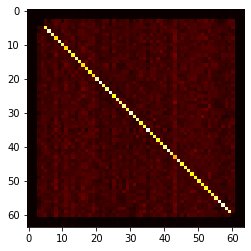

[[0.00045599 0.00045599 0.00045599 ... 0.00014461 0.00030293 0.00052783]
 [0.00045599 0.00045599 0.00045599 ... 0.00021804 0.00039031 0.00060945]
 [0.00045599 0.00045599 0.00045599 ... 0.000212   0.00025454 0.00050256]
 ...
 [0.00014708 0.00020978 0.00021082 ... 0.00045599 0.00045599 0.00045599]
 [0.0003068  0.00037394 0.00025205 ... 0.00045599 0.00045599 0.00045599]
 [0.00049471 0.00054036 0.00046055 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)


In [3]:
PATH_TO_CKPT = '/tmp/repnet_ckpt/'
!mkdir $PATH_TO_CKPT
!wget -nc -P $PATH_TO_CKPT https://storage.googleapis.com/repnet_ckpt/checkpoint
!wget -nc -P $PATH_TO_CKPT https://storage.googleapis.com/repnet_ckpt/ckpt-88.data-00000-of-00002
!wget -nc -P $PATH_TO_CKPT https://storage.googleapis.com/repnet_ckpt/ckpt-88.data-00001-of-00002
!wget -nc -P $PATH_TO_CKPT https://storage.googleapis.com/repnet_ckpt/ckpt-88.index

model = get_repnet_model(PATH_TO_CKPT)

## Set Params



In [4]:
##@title 

# FPS while recording video from webcam.
WEBCAM_FPS = 16#@param {type:"integer"}

# Time in seconds to record video on webcam. 
RECORDING_TIME_IN_SECONDS = 8. #@param {type:"number"}

# Threshold to consider periodicity in entire video.
THRESHOLD = 0.2#@param {type:"number"}

# Threshold to consider periodicity for individual frames in video.
WITHIN_PERIOD_THRESHOLD = 0.5#@param {type:"number"}

# Use this setting for better results when it is 
# known action is repeating at constant speed.
CONSTANT_SPEED = False#@param {type:"boolean"}

# Use median filtering in time to ignore noisy frames.
MEDIAN_FILTER = True#@param {type:"boolean"}

# Use this setting for better results when it is 
# known the entire video is periodic/reapeating and
# has no aperiodic frames.
FULLY_PERIODIC = False#@param {type:"boolean"}

# Plot score in visualization video.
PLOT_SCORE = False#@param {type:"boolean"}

# Visualization video's FPS.
VIZ_FPS = 30#@param {type:"integer"}

# Get input video

We provide 3 ways to get input video:
1. upload video to your Google Drive.
2. provide URL of a video.
3. record video using webcam.

## Get Video from Drive

If you have uploaded an input video to your Drive, update `PATH_TO_VIDEO_ON_YOUR_DRIVE` below.

This step needs your authorization in order to access the videos from your Google Drive. Running the next code cell will ask for that permission.

In [ ]:
# Uncomment and run these lines to load videos from Google Drive.

# drive.mount('/content/gdrive')

# PATH_TO_VIDEO_ON_YOUR_DRIVE = "gdrive/My Drive/<PATH_TO_VIDEO>.mp4"
# imgs, vid_fps = read_video(PATH_TO_VIDEO_ON_YOUR_DRIVE)
# show_video(PATH_TO_VIDEO_ON_YOUR_DRIVE)

## Get Video from URL

Provide a link to mp4/gif hosted online.

In [5]:
imgs, vid_fps = read_video("./20201125_1123_1233_cut_count_gray_out.mp4")
show_video("./20201125_1123_1233_cut_count_gray_out.mp4")

## Get Video from Webcam

You will be asked for permission for this page to access your webcam.

### Run following code to capture webcam video

In [ ]:
# Uncomment and run these lines to record video using webcam.

# INTERVAL_IN_MS = 1000//WEBCAM_FPS
# vid_fps = WEBCAM_FPS
# imgs = []
# output.register_callback('notebook.get_webcam_video', get_webcam_video)
# record_video(INTERVAL_IN_MS, int(RECORDING_TIME_IN_SECONDS*1000/INTERVAL_IN_MS))

# Run RepNet

Running RepNet...
4096


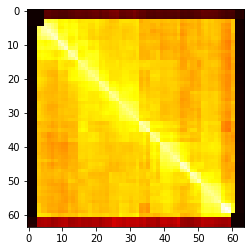

[[0.00045599 0.00045599 0.00045599 ... 0.00123638 0.00123016 0.00142154]
 [0.00045599 0.00045599 0.00045599 ... 0.00121979 0.00120961 0.00142686]
 [0.00045599 0.00045599 0.00045599 ... 0.00122531 0.0012157  0.00142566]
 ...
 [0.00102783 0.00101099 0.00099891 ... 0.00045599 0.00045599 0.00045599]
 [0.00100798 0.00098817 0.00097684 ... 0.00045599 0.00045599 0.00045599]
 [0.00125382 0.00125473 0.0012331  ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


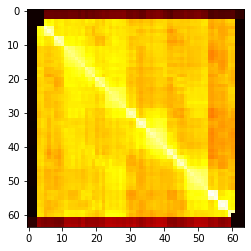

[[0.00045599 0.00045599 0.00045599 ... 0.00180771 0.00176875 0.00183955]
 [0.00045599 0.00045599 0.00045599 ... 0.00177405 0.00173759 0.00180193]
 [0.00045599 0.00045599 0.00045599 ... 0.00178632 0.00174827 0.00181442]
 ...
 [0.00155183 0.00155867 0.00156717 ... 0.00045599 0.00045599 0.00045599]
 [0.00151758 0.00152582 0.00153297 ... 0.00045599 0.00045599 0.00045599]
 [0.00155413 0.00155807 0.0015666  ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


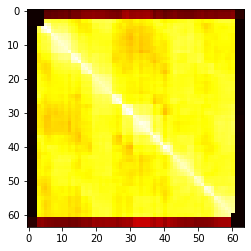

[[0.00045599 0.00045599 0.00045599 ... 0.00134759 0.00133314 0.00136677]
 [0.00045599 0.00045599 0.00045599 ... 0.00141903 0.00140051 0.00143075]
 [0.00045599 0.00045599 0.00045599 ... 0.00144368 0.0014215  0.00145268]
 ...
 [0.00117246 0.001306   0.00132919 ... 0.00045599 0.00045599 0.00045599]
 [0.00115164 0.00127979 0.00129946 ... 0.00045599 0.00045599 0.00045599]
 [0.00118602 0.00131331 0.00133396 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


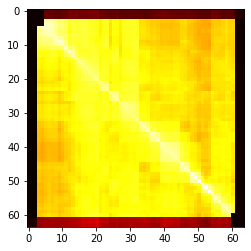

[[0.00045599 0.00045599 0.00045599 ... 0.00107257 0.00118482 0.0010726 ]
 [0.00045599 0.00045599 0.00045599 ... 0.00106037 0.00117302 0.00107398]
 [0.00045599 0.00045599 0.00045599 ... 0.00106189 0.0011793  0.00108181]
 ...
 [0.00092498 0.00092575 0.00092858 ... 0.00045599 0.00045599 0.00045599]
 [0.00099988 0.00100214 0.00100915 ... 0.00045599 0.00045599 0.00045599]
 [0.00095023 0.00096319 0.0009718  ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


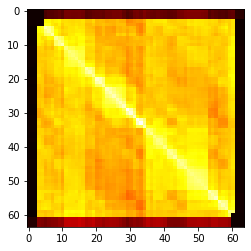

[[0.00045599 0.00045599 0.00045599 ... 0.0015032  0.00142253 0.0014137 ]
 [0.00045599 0.00045599 0.00045599 ... 0.00151714 0.00143562 0.00142746]
 [0.00045599 0.00045599 0.00045599 ... 0.00161688 0.00152566 0.00151701]
 ...
 [0.00127184 0.0012904  0.00135901 ... 0.00045599 0.00045599 0.00045599]
 [0.00119763 0.00121503 0.00127599 ... 0.00045599 0.00045599 0.00045599]
 [0.00119592 0.00121393 0.00127486 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


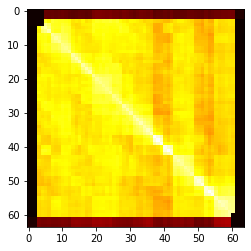

[[0.00045599 0.00045599 0.00045599 ... 0.00115409 0.00119858 0.0012106 ]
 [0.00045599 0.00045599 0.00045599 ... 0.00102954 0.00106982 0.00107899]
 [0.00045599 0.00045599 0.00045599 ... 0.00107306 0.00111588 0.00112264]
 ...
 [0.00102789 0.00094123 0.00097843 ... 0.00045599 0.00045599 0.00045599]
 [0.00105462 0.00096625 0.00100519 ... 0.00045599 0.00045599 0.00045599]
 [0.00108873 0.00099606 0.00103362 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


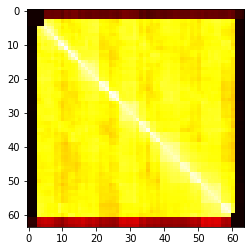

[[0.00045599 0.00045599 0.00045599 ... 0.00184339 0.00181577 0.00146023]
 [0.00045599 0.00045599 0.00045599 ... 0.00183628 0.00179911 0.00145652]
 [0.00045599 0.00045599 0.00045599 ... 0.0017872  0.00174164 0.00140185]
 ...
 [0.00147806 0.00148504 0.00143314 ... 0.00045599 0.00045599 0.00045599]
 [0.00148616 0.00148522 0.00142562 ... 0.00045599 0.00045599 0.00045599]
 [0.00129906 0.00130692 0.00124724 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


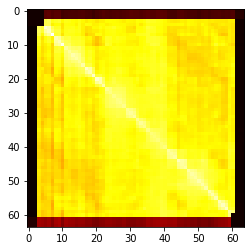

[[0.00045599 0.00045599 0.00045599 ... 0.00108512 0.00109784 0.00111717]
 [0.00045599 0.00045599 0.00045599 ... 0.00114196 0.0011495  0.00116095]
 [0.00045599 0.00045599 0.00045599 ... 0.00118505 0.00119251 0.00120273]
 ...
 [0.00093288 0.00099544 0.00102931 ... 0.00045599 0.00045599 0.00045599]
 [0.00092994 0.00098728 0.00102055 ... 0.00045599 0.00045599 0.00045599]
 [0.00096129 0.0010129  0.00104561 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


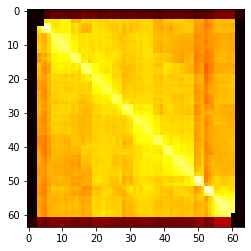

[[0.00045599 0.00045599 0.00045599 ... 0.0015416  0.00161674 0.0015756 ]
 [0.00045599 0.00045599 0.00045599 ... 0.00169579 0.00176869 0.00171806]
 [0.00045599 0.00045599 0.00045599 ... 0.00175538 0.00183296 0.00178564]
 ...
 [0.00120631 0.00145803 0.00150393 ... 0.00045599 0.00045599 0.00045599]
 [0.00127086 0.00152764 0.00157755 ... 0.00045599 0.00045599 0.00045599]
 [0.00125707 0.00150612 0.00155983 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


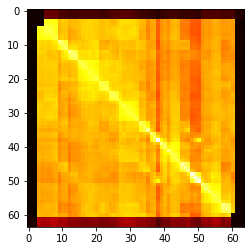

[[0.00045599 0.00045599 0.00045599 ... 0.00115718 0.00114341 0.00097471]
 [0.00045599 0.00045599 0.00045599 ... 0.00118222 0.00116813 0.00099572]
 [0.00045599 0.00045599 0.00045599 ... 0.00120209 0.00117943 0.001011  ]
 ...
 [0.00096051 0.00098873 0.0009984  ... 0.00045599 0.00045599 0.00045599]
 [0.00095233 0.00098029 0.00098293 ... 0.00045599 0.00045599 0.00045599]
 [0.00087198 0.00089752 0.00090499 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


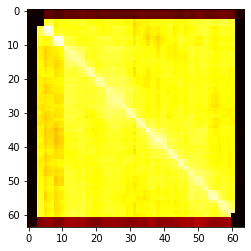

[[0.00045599 0.00045599 0.00045599 ... 0.00106594 0.00106098 0.00110421]
 [0.00045599 0.00045599 0.00045599 ... 0.0010549  0.00105003 0.00109208]
 [0.00045599 0.00045599 0.00045599 ... 0.00109835 0.00109447 0.00113319]
 ...
 [0.00094442 0.00094055 0.0009712  ... 0.00045599 0.00045599 0.00045599]
 [0.00094157 0.00093775 0.00096936 ... 0.00045599 0.00045599 0.00045599]
 [0.00097856 0.00097393 0.00100225 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


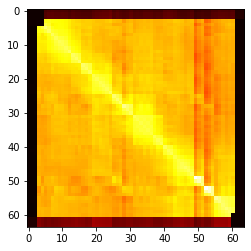

[[0.00045599 0.00045599 0.00045599 ... 0.00110441 0.00113577 0.00111435]
 [0.00045599 0.00045599 0.00045599 ... 0.0011607  0.00119362 0.00118073]
 [0.00045599 0.00045599 0.00045599 ... 0.00118578 0.00121922 0.00121054]
 ...
 [0.00091729 0.00099847 0.00103025 ... 0.00045599 0.00045599 0.00045599]
 [0.00094263 0.00102603 0.00105851 ... 0.00045599 0.00045599 0.00045599]
 [0.00091935 0.0010089  0.00104472 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


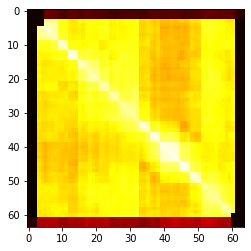

[[0.00045599 0.00045599 0.00045599 ... 0.00171884 0.00166007 0.00149003]
 [0.00045599 0.00045599 0.00045599 ... 0.00163035 0.00158398 0.00141854]
 [0.00045599 0.00045599 0.00045599 ... 0.00154532 0.0015003  0.00134665]
 ...
 [0.0013742  0.00131462 0.00123711 ... 0.00045599 0.00045599 0.00045599]
 [0.00132827 0.00127824 0.00120202 ... 0.00045599 0.00045599 0.00045599]
 [0.00124547 0.00119587 0.00112712 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


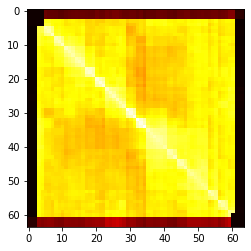

[[0.00045599 0.00045599 0.00045599 ... 0.0015086  0.00149553 0.00147323]
 [0.00045599 0.00045599 0.00045599 ... 0.00152754 0.00151498 0.001492  ]
 [0.00045599 0.00045599 0.00045599 ... 0.00151975 0.00150859 0.00148649]
 ...
 [0.00135103 0.00137614 0.00137149 ... 0.00045599 0.00045599 0.00045599]
 [0.00132893 0.00135421 0.00135084 ... 0.00045599 0.00045599 0.00045599]
 [0.0013167  0.00134142 0.00133877 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


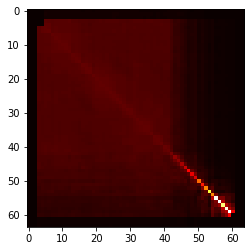

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.4574109e-05
  9.8514764e-05 1.0462627e-04]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.2414703e-05
  1.0580127e-04 1.1519859e-04]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.0540416e-05
  1.0180266e-04 1.1088874e-04]
 ...
 [1.0221491e-04 1.1843394e-04 1.1534054e-04 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.4958116e-04 1.6598168e-04 1.5966990e-04 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.7751346e-04 2.0194417e-04 1.9434188e-04 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


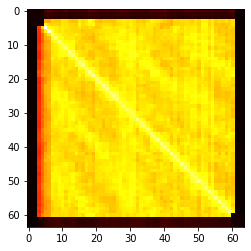

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.9635585e-05
  2.7685115e-05 2.2973358e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.8659526e-05
  2.6779069e-05 2.1656424e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.3264878e-05
  3.1624695e-05 2.5234982e-05]
 ...
 [2.3325154e-05 2.4003732e-05 2.4903889e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.1583608e-05 2.2216307e-05 2.3451697e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.8403802e-05 1.8461566e-05 1.9228984e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


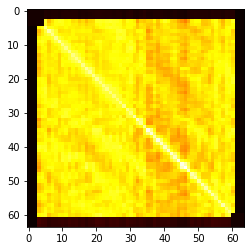

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.48319505e-05
  1.56486258e-05 1.61533735e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.56567585e-05
  1.65656711e-05 1.72167529e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.93524647e-05
  2.05307897e-05 2.12869018e-05]
 ...
 [1.38089354e-05 1.48950794e-05 1.79739745e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.45152644e-05 1.57013455e-05 1.89976672e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.51766235e-05 1.65288347e-05 1.99512560e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


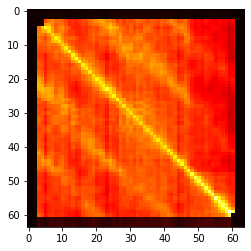

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.5163085e-05
  2.1797572e-05 2.3167551e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.4133595e-05
  2.0828002e-05 2.2073968e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.3908400e-05
  2.0877394e-05 2.2696328e-05]
 ...
 [2.4579447e-05 2.4251191e-05 2.3000364e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.9681891e-05 1.9346800e-05 1.8565685e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.1579643e-05 2.1151802e-05 2.0820717e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


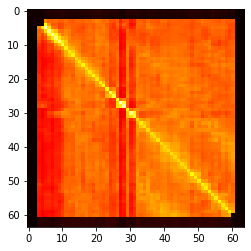

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.2200260e-05
  3.4815454e-05 3.1197123e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.4175268e-05
  3.6752088e-05 3.3285334e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.1732667e-05
  3.3454005e-05 3.0825537e-05]
 ...
 [2.7656484e-05 3.1039024e-05 2.6993648e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.9776922e-05 3.3239026e-05 2.8338267e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.6719228e-05 3.0145386e-05 2.6147938e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


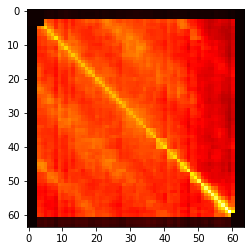

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.9959929e-05
  2.4521283e-05 3.8185088e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.2466211e-05
  2.6021313e-05 4.0329665e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.9325285e-05
  3.1602129e-05 4.9857103e-05]
 ...
 [3.0915649e-05 3.4038007e-05 4.0524919e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.4488389e-05 2.6402262e-05 3.1517087e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [3.8298520e-05 4.1096780e-05 4.9937637e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


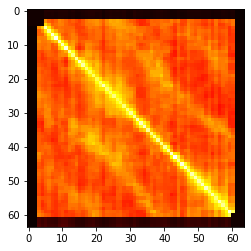

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.6348651e-05
  3.7235484e-05 3.1596883e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.1446983e-05
  3.3180157e-05 2.8545855e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.2032116e-05
  3.6042988e-05 3.0436629e-05]
 ...
 [3.3473789e-05 2.9466599e-05 2.8899227e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [3.2778462e-05 2.9719702e-05 3.1083964e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.7802722e-05 2.5557631e-05 2.6237572e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


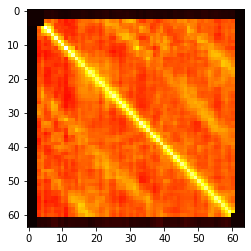

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.1593982e-05
  3.2663454e-05 3.3745360e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.2595803e-05
  3.4662775e-05 3.5559548e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.4843014e-05
  2.3379214e-05 2.5024916e-05]
 ...
 [1.9913268e-05 2.2449916e-05 1.3798635e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.8686920e-05 3.2799129e-05 2.0699314e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [3.1016873e-05 3.5214158e-05 2.3187866e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


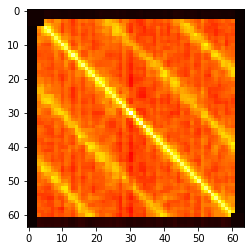

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.5594704e-05
  2.2048442e-05 2.3960420e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.8737139e-05
  2.6012453e-05 2.8094346e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.6171138e-05
  2.2352828e-05 2.4109522e-05]
 ...
 [1.6051308e-05 1.9586570e-05 1.6242964e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.1464915e-05 2.5719017e-05 2.1236117e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.4021927e-05 2.8605804e-05 2.3588122e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


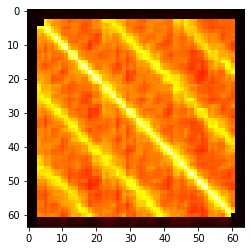

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.7852661e-05
  2.0643571e-05 1.8983030e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.7977443e-05
  2.0671574e-05 1.9701791e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.7971464e-05
  2.0775138e-05 2.0083771e-05]
 ...
 [1.7583483e-05 1.7654052e-05 1.7682007e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.9717309e-05 1.9685705e-05 1.9822250e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.9774834e-05 2.0462923e-05 2.0899637e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


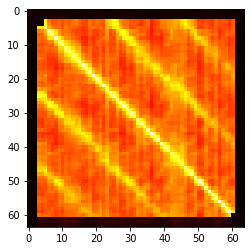

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.7915179e-05
  2.4029103e-05 2.0388936e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.5435086e-05
  2.0538420e-05 1.7255610e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.6520646e-05
  2.1504060e-05 1.8168466e-05]
 ...
 [1.8526220e-05 1.5932250e-05 1.6841215e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.4243936e-05 2.0684023e-05 2.1387834e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.1616450e-05 1.8260913e-05 1.8988419e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


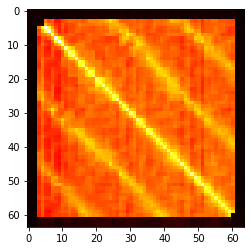

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.3153840e-05
  2.1374404e-05 1.9247580e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.7776556e-05
  1.6658792e-05 1.5393251e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.1244843e-05
  1.9622539e-05 1.8098795e-05]
 ...
 [2.0796613e-05 1.6659136e-05 1.9328105e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.8589719e-05 1.5116723e-05 1.7286229e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.7133887e-05 1.4297016e-05 1.6319082e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


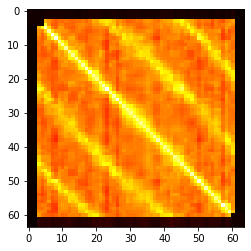

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.3395436e-05
  2.2244727e-05 2.2046897e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.3407885e-05
  2.2233820e-05 2.2160642e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.5811813e-05
  2.4636429e-05 2.4607523e-05]
 ...
 [2.2680208e-05 2.2923692e-05 2.5151576e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.1453363e-05 2.1661519e-05 2.3882340e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.1755966e-05 2.2091221e-05 2.4407856e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


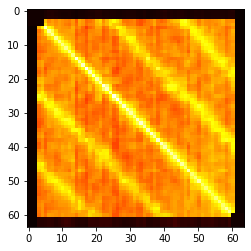

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.4860186e-05
  2.4622746e-05 2.5577176e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.2731889e-05
  2.2751301e-05 2.3406377e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.1615340e-05
  2.1402911e-05 2.2117320e-05]
 ...
 [2.2646620e-05 2.1218524e-05 1.9596249e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.2244747e-05 2.1060943e-05 1.9243131e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.3894294e-05 2.2405591e-05 2.0562977e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


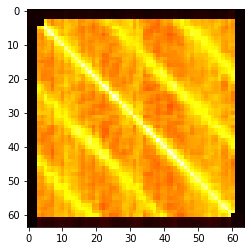

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.5259196e-05
  2.0231113e-05 2.0827125e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.5822401e-05
  2.0578440e-05 2.1361859e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.2480823e-05
  1.7801594e-05 1.8473220e-05]
 ...
 [2.4020308e-05 2.4933353e-05 2.1057511e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.9159643e-05 1.9788147e-05 1.6605896e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.0039941e-05 2.0870422e-05 1.7508361e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


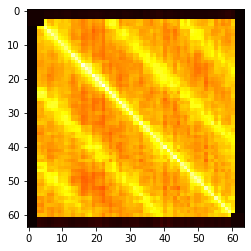

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.57278846e-05
  1.39536933e-05 1.26681889e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.76217854e-05
  1.53790406e-05 1.41419587e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.88769482e-05
  1.66177051e-05 1.52399725e-05]
 ...
 [1.47733217e-05 1.67947492e-05 1.76326012e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.30393955e-05 1.45818731e-05 1.54424433e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.19766637e-05 1.35658374e-05 1.43278876e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


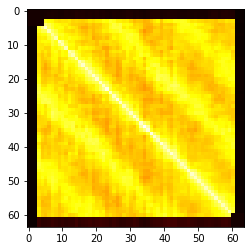

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.42879735e-05
  1.52766715e-05 1.20669692e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.40878365e-05
  1.50240521e-05 1.20616241e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.55525067e-05
  1.65848542e-05 1.33527647e-05]
 ...
 [1.36894087e-05 1.36816034e-05 1.51465674e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.43792677e-05 1.43342086e-05 1.58678995e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.15218818e-05 1.16737301e-05 1.29597383e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


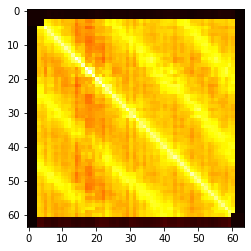

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.0021365e-05
  2.1125006e-05 1.9128694e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.8956520e-05
  2.0046953e-05 1.8306146e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.9779229e-05
  2.0995089e-05 1.9119818e-05]
 ...
 [1.8941237e-05 1.8040464e-05 1.8483663e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.9585737e-05 1.8696739e-05 1.9227587e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.7769744e-05 1.7106735e-05 1.7544606e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


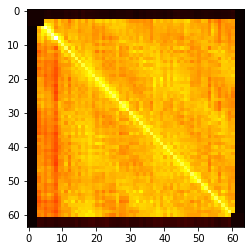

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.7660810e-05
  2.7128985e-05 2.7399732e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.7384976e-05
  2.6604162e-05 2.6673621e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.0235396e-05
  2.9472249e-05 2.9340190e-05]
 ...
 [2.6323014e-05 2.6788945e-05 2.9055589e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.5735129e-05 2.5942687e-05 2.8232504e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.6329300e-05 2.6347989e-05 2.8470771e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


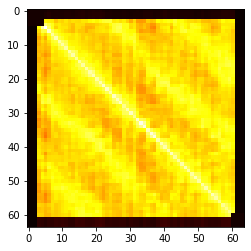

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.0695301e-05
  1.7961467e-05 1.8216206e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.9213951e-05
  1.6621709e-05 1.6739043e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.0020281e-05
  1.7318560e-05 1.7623477e-05]
 ...
 [1.8123259e-05 1.7602710e-05 1.8246999e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.5860260e-05 1.5354739e-05 1.5916112e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.6300808e-05 1.5670399e-05 1.6413434e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


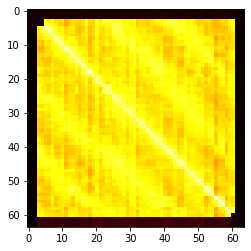

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.5698131e-05
  1.7226297e-05 1.7478877e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.5737674e-05
  1.7130640e-05 1.7516655e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.7072261e-05
  1.8747869e-05 1.9132978e-05]
 ...
 [1.4839601e-05 1.5083802e-05 1.6157113e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.6252236e-05 1.6386672e-05 1.7708082e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.6372169e-05 1.6635655e-05 1.7942119e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


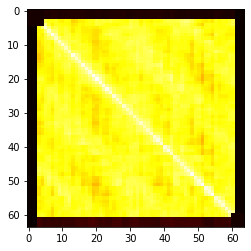

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.32762016e-05
  1.52438297e-05 1.49848283e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.45360891e-05
  1.67993985e-05 1.67272829e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.48690715e-05
  1.69725790e-05 1.69548784e-05]
 ...
 [1.24068083e-05 1.38234482e-05 1.39585054e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.40269931e-05 1.57306549e-05 1.56887054e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.39936483e-05 1.58959756e-05 1.59053325e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


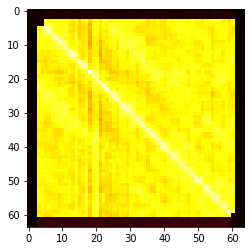

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.5515747e-05
  1.4474836e-05 1.7410701e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.4629432e-05
  1.3721485e-05 1.6684471e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.7069295e-05
  1.5968339e-05 1.9524799e-05]
 ...
 [1.4200787e-05 1.3631480e-05 1.5936086e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.3269993e-05 1.2806604e-05 1.4932865e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.6028887e-05 1.5637790e-05 1.8335808e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


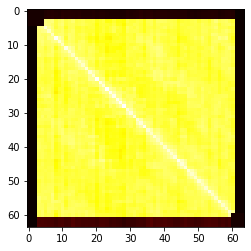

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.32924815e-05
  1.35805303e-05 1.37408751e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.43038642e-05
  1.46334096e-05 1.48231402e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.53600777e-05
  1.57380437e-05 1.58720559e-05]
 ...
 [1.24920416e-05 1.34940110e-05 1.45062459e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.27318817e-05 1.37715142e-05 1.48272584e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.30399194e-05 1.41208575e-05 1.51365866e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


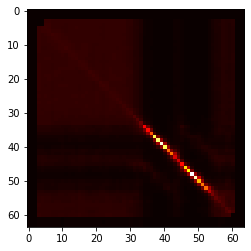

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.7593860e-05
  3.2635166e-05 1.9000321e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.5477933e-05
  2.9409979e-05 1.7092307e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.3005307e-05
  2.6859274e-05 1.5567819e-05]
 ...
 [2.8756833e-05 2.7047361e-05 2.4315837e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [3.3425124e-05 3.0684147e-05 2.7900636e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.0897647e-05 1.9150022e-05 1.7365881e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


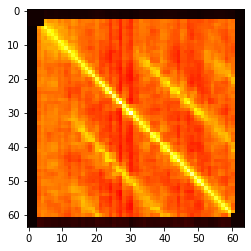

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.6997097e-05
  1.8698520e-05 1.6955213e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.2740078e-05
  2.4899840e-05 2.2239396e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.4206513e-05
  2.6655291e-05 2.3358591e-05]
 ...
 [1.6861875e-05 2.3533241e-05 2.4989489e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.7278207e-05 2.4001960e-05 2.5631200e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.6577284e-05 2.2682545e-05 2.3765708e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


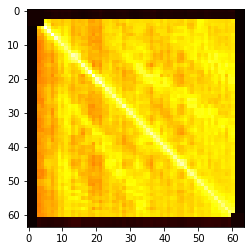

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.6925216e-05
  1.9093046e-05 1.6197182e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.2089029e-05
  2.5393008e-05 2.1786967e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.9852650e-05
  2.2616852e-05 1.9409934e-05]
 ...
 [1.4250723e-05 1.9278119e-05 1.6866969e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.6012860e-05 2.2074621e-05 1.9139989e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.3715755e-05 1.9123279e-05 1.6585178e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


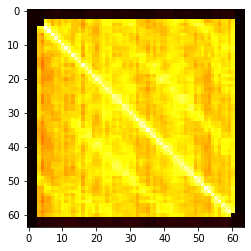

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.5736221e-05
  1.7106693e-05 1.7398554e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.4160986e-05
  1.5107464e-05 1.5525651e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.9495386e-05
  2.1282160e-05 2.1371427e-05]
 ...
 [1.4234487e-05 1.2859113e-05 1.6996692e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.5410433e-05 1.3662069e-05 1.8478029e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.5587593e-05 1.3963423e-05 1.8454004e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


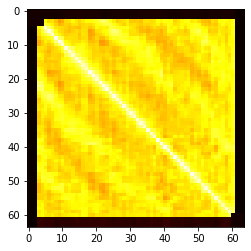

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 9.80978803e-06
  9.90869194e-06 1.05352310e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.08839804e-05
  1.10359424e-05 1.15456669e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.10850506e-05
  1.13676806e-05 1.18662274e-05]
 ...
 [9.16837507e-06 1.02875701e-05 1.02170652e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [9.17977286e-06 1.03399225e-05 1.03858774e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [9.86244231e-06 1.09307930e-05 1.09549092e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


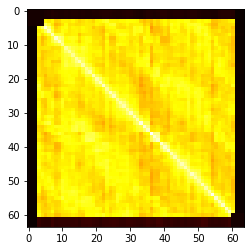

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.1779329e-05
  1.9728706e-05 1.8902603e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.0017473e-05
  1.8198380e-05 1.7362117e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.6690174e-05
  1.5206651e-05 1.4524798e-05]
 ...
 [2.0755451e-05 1.9286337e-05 1.6033935e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.8829835e-05 1.7560358e-05 1.4630967e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.8601841e-05 1.7273876e-05 1.4409071e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


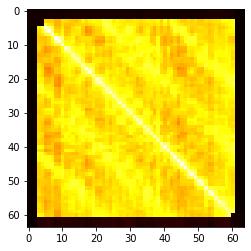

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 9.2980081e-06
  9.7275251e-06 8.9720625e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.8865518e-06
  9.3468370e-06 8.6189257e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.9928544e-06
  9.5709911e-06 8.8791130e-06]
 ...
 [8.5823112e-06 8.4924750e-06 8.3992272e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [8.8459446e-06 8.8002134e-06 8.8069637e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [8.2869847e-06 8.2422166e-06 8.2985307e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


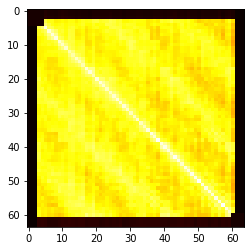

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.68375864e-05
  1.62158522e-05 1.54384306e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.43775751e-05
  1.38153910e-05 1.32101350e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.40431639e-05
  1.33667154e-05 1.24848175e-05]
 ...
 [1.60544878e-05 1.39449485e-05 1.33871245e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.54716708e-05 1.34083484e-05 1.27505218e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.50763353e-05 1.31224406e-05 1.21893527e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


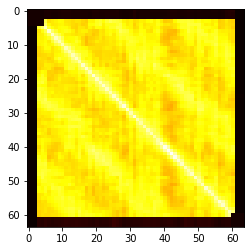

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.3811756e-05
  1.1960525e-05 1.2258075e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.4229016e-05
  1.2157927e-05 1.2521976e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.1594954e-05
  9.8120026e-06 1.0094971e-05]
 ...
 [1.3583374e-05 1.4066443e-05 1.1386531e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.1707068e-05 1.1962119e-05 9.5900132e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.2174342e-05 1.2501057e-05 1.0011333e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


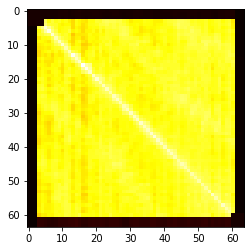

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.1277905e-05
  1.1257671e-05 1.1209280e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.1510918e-05
  1.1492445e-05 1.1542423e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.1653024e-05
  1.1623578e-05 1.1688819e-05]
 ...
 [1.0775534e-05 1.1110770e-05 1.1190974e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.0651833e-05 1.0985306e-05 1.1054384e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.0840941e-05 1.1277430e-05 1.1362628e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


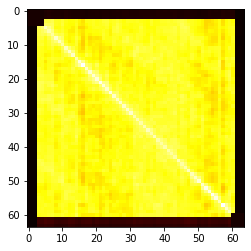

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.3292075e-05
  1.3765532e-05 1.3824984e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.3318317e-05
  1.3822811e-05 1.3814442e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.4505959e-05
  1.5242283e-05 1.5206435e-05]
 ...
 [1.3094940e-05 1.3188964e-05 1.4209490e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.3417775e-05 1.3543611e-05 1.4772664e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.3944472e-05 1.4006234e-05 1.5250572e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


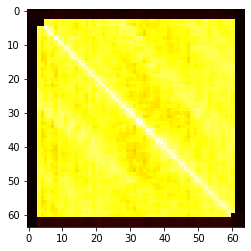

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.21998901e-05
  1.16749598e-05 1.15135381e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.07371579e-05
  1.02947724e-05 1.01961759e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.48716135e-05
  1.41764849e-05 1.39326139e-05]
 ...
 [1.14519335e-05 1.01526539e-05 1.39377116e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.09859975e-05 9.75816693e-06 1.33187405e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.10267565e-05 9.83656901e-06 1.33223884e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


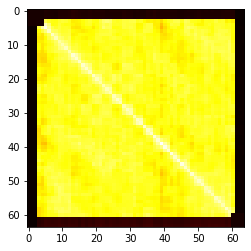

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.15061157e-05
  1.28770243e-05 1.33999110e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 9.47469471e-06
  1.06750085e-05 1.11413710e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 9.96162908e-06
  1.12602120e-05 1.18169746e-05]
 ...
 [1.10548099e-05 9.22380514e-06 9.68105996e-06 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.20893010e-05 1.01549140e-05 1.06930647e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.28518777e-05 1.08274353e-05 1.14641252e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


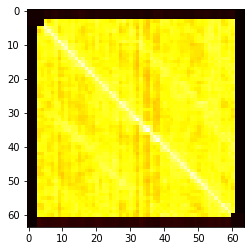

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.23145637e-05
  1.31316074e-05 1.29529371e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.39433887e-05
  1.48868621e-05 1.45986587e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.22633928e-05
  1.30880089e-05 1.26962859e-05]
 ...
 [1.19630695e-05 1.37593797e-05 1.17651271e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.27865260e-05 1.47246428e-05 1.25855040e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.28906213e-05 1.47579303e-05 1.24779908e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


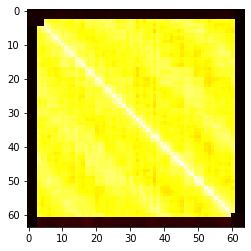

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 9.6728299e-06
  9.8834307e-06 9.8157243e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 9.9702611e-06
  1.0156848e-05 1.0110933e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.0296241e-05
  1.0492810e-05 1.0394141e-05]
 ...
 [9.3296976e-06 9.6610593e-06 1.0064525e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [9.4435036e-06 9.7496395e-06 1.0160564e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [9.6922495e-06 1.0029923e-05 1.0401390e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


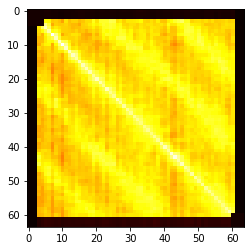

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.2696141e-05
  1.1804898e-05 1.2618332e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.1233236e-05
  1.0483827e-05 1.1225943e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.1079292e-05
  1.0319946e-05 1.1128978e-05]
 ...
 [1.1543989e-05 1.0705798e-05 1.0391130e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.0656527e-05 9.9198069e-06 9.6094273e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.1613134e-05 1.0829298e-05 1.0564998e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


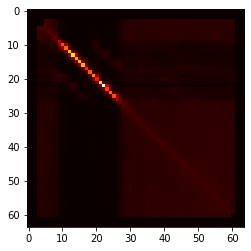

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.71052452e-05
  1.69517662e-05 1.53905148e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.58668718e-05
  1.57119721e-05 1.42017998e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.54070785e-05
  1.51981285e-05 1.37237275e-05]
 ...
 [1.76336780e-05 1.66443260e-05 1.58128023e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.70030144e-05 1.60362579e-05 1.51766562e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.57523082e-05 1.47909404e-05 1.39842159e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


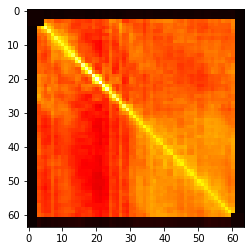

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.5578613e-05
  1.3931910e-05 1.4450893e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.6602176e-05
  1.4991094e-05 1.5582711e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.8787681e-05
  1.7063803e-05 1.7421926e-05]
 ...
 [1.3820092e-05 1.5332413e-05 1.6850221e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.2238741e-05 1.3709538e-05 1.5154870e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.2720566e-05 1.4279669e-05 1.5504515e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


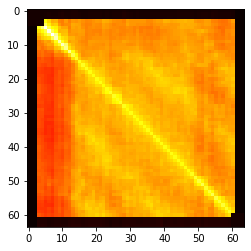

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.16666815e-05
  1.28814772e-05 1.38599980e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.14137320e-05
  1.25597880e-05 1.35507562e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.26391624e-05
  1.39737303e-05 1.51961103e-05]
 ...
 [1.07330015e-05 1.09800058e-05 1.19809301e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.17930613e-05 1.20238683e-05 1.31817051e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.26775531e-05 1.29609498e-05 1.43219813e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


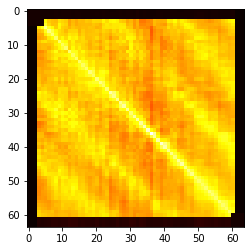

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.2140732e-06
  8.7842964e-06 8.0676991e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.7098142e-06
  9.3430817e-06 8.5831834e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.3474370e-06
  8.9132909e-06 8.1996095e-06]
 ...
 [7.6593251e-06 8.2570214e-06 7.7409177e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [8.1463040e-06 8.8089937e-06 8.2205142e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [7.5006910e-06 8.1130202e-06 7.5814460e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


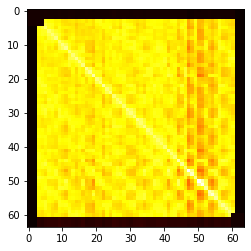

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.0746588e-06
  6.3644579e-06 6.6840116e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.1434766e-06
  6.4243300e-06 6.7944588e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.6029229e-06
  6.8753757e-06 7.2117664e-06]
 ...
 [5.7938591e-06 5.9042350e-06 6.2948452e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [6.0291773e-06 6.1323631e-06 6.5102231e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [6.3963926e-06 6.5517324e-06 6.8983040e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


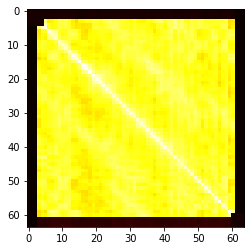

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.9670311e-06
  1.0106307e-05 9.4978086e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.2048900e-06
  9.2755890e-06 8.7922253e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.7678678e-06
  8.8188608e-06 8.3583882e-06]
 ...
 [9.0278727e-06 8.4363000e-06 7.9396877e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [9.8923656e-06 9.2723913e-06 8.7636490e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [9.3519448e-06 8.8413763e-06 8.3553741e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


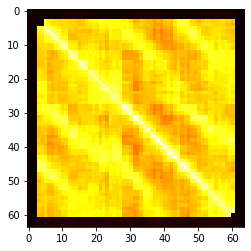

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.7961651e-06
  6.7619521e-06 6.3117473e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.0847328e-06
  6.0839384e-06 5.6607878e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 5.5292480e-06
  5.4696216e-06 5.0689605e-06]
 ...
 [6.4700521e-06 5.9067615e-06 5.2668111e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [6.3381012e-06 5.8148157e-06 5.1295847e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [5.9852164e-06 5.4735765e-06 4.8093571e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


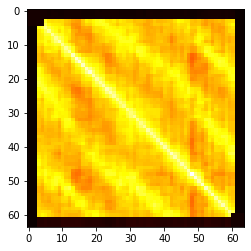

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.2128311e-06
  5.8999890e-06 5.5451542e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.7744554e-06
  6.4095780e-06 6.0171487e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.8291442e-06
  6.5108306e-06 6.1172691e-06]
 ...
 [5.9325780e-06 6.4949472e-06 6.4965338e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [5.6016543e-06 6.1100091e-06 6.1583301e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [5.2510277e-06 5.7209572e-06 5.7709826e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


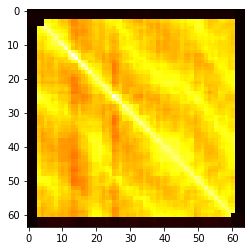

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.7262011e-06
  7.0043402e-06 6.7638171e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.1772414e-06
  7.4295604e-06 7.1761183e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.8140711e-06
  7.0781589e-06 6.8391955e-06]
 ...
 [7.3163296e-06 7.8688381e-06 7.4526170e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [6.5503064e-06 7.0604765e-06 6.6668222e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [6.3720545e-06 6.8699533e-06 6.4892852e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


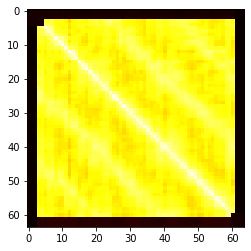

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.6006594e-06
  8.5795973e-06 7.5245493e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.4999001e-06
  8.4785515e-06 7.4372415e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.8028810e-06
  8.7821190e-06 7.7328432e-06]
 ...
 [8.1179414e-06 8.1151939e-06 8.1313538e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [8.0917598e-06 8.0885111e-06 8.1058624e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [7.1262211e-06 7.1246172e-06 7.1670738e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


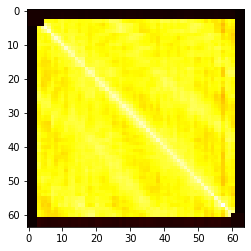

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.5802233e-06
  5.8615196e-06 5.9924869e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.3939406e-06
  5.7035463e-06 5.8219489e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.3900816e-06
  5.7328953e-06 5.8446572e-06]
 ...
 [6.3513653e-06 6.2721933e-06 6.2277227e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [5.5575438e-06 5.4959401e-06 5.4883662e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [5.7615139e-06 5.6888211e-06 5.6739423e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


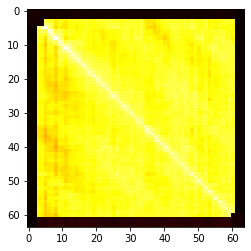

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.4649930e-06
  6.0279390e-06 6.2325744e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.8163449e-06
  6.3580901e-06 6.5173836e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.0328506e-06
  6.5628187e-06 6.7256960e-06]
 ...
 [6.1853193e-06 6.5780810e-06 6.7481160e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [5.7239863e-06 6.0898979e-06 6.2499598e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [5.9122590e-06 6.2360973e-06 6.3985312e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


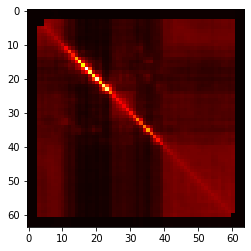

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.8458334e-06
  7.9283682e-06 8.1485086e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.5934199e-06
  7.6262372e-06 7.8150670e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.8401157e-06
  8.9747382e-06 9.1944312e-06]
 ...
 [7.5342123e-06 7.3378937e-06 8.3984833e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [7.5736712e-06 7.3310830e-06 8.4818103e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [7.8500343e-06 7.5763728e-06 8.7631943e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


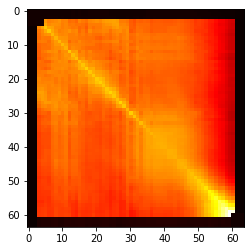

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 4.5941852e-06
  4.5973761e-06 4.2834399e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 4.5626848e-06
  4.5828187e-06 4.2783513e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 4.4044245e-06
  4.4302060e-06 4.1480316e-06]
 ...
 [4.2849060e-06 4.3266627e-06 4.1265348e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [4.2454503e-06 4.3027512e-06 4.1096159e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [3.9947222e-06 4.0566742e-06 3.8859707e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


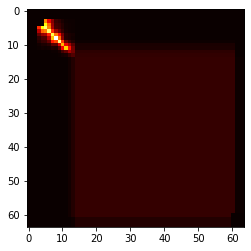

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.7944390e-05
  1.7944390e-05 1.7944390e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.2735185e-05
  1.2735185e-05 1.2735185e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.3661784e-05
  1.3661784e-05 1.3661784e-05]
 ...
 [6.7473261e-06 5.1999059e-06 5.4955854e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [6.7473261e-06 5.1999059e-06 5.4955854e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [6.7473261e-06 5.1999059e-06 5.4955854e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


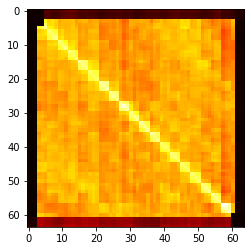

[[0.00045599 0.00045599 0.00045599 ... 0.00119105 0.00116714 0.00129835]
 [0.00045599 0.00045599 0.00045599 ... 0.00113564 0.00111934 0.00122603]
 [0.00045599 0.00045599 0.00045599 ... 0.00109912 0.00107957 0.00116687]
 ...
 [0.00098023 0.00092692 0.00089945 ... 0.00045599 0.00045599 0.00045599]
 [0.0009731  0.00092555 0.00089498 ... 0.00045599 0.00045599 0.00045599]
 [0.00112394 0.00105258 0.0010044  ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


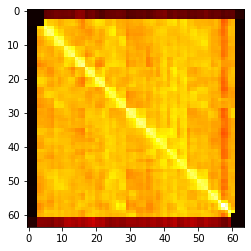

[[0.00045599 0.00045599 0.00045599 ... 0.0014736  0.00143324 0.00145006]
 [0.00045599 0.00045599 0.00045599 ... 0.00156654 0.00152962 0.00154816]
 [0.00045599 0.00045599 0.00045599 ... 0.00151947 0.00151835 0.00152503]
 ...
 [0.00137275 0.00147055 0.00135847 ... 0.00045599 0.00045599 0.00045599]
 [0.00124406 0.00133794 0.00126485 ... 0.00045599 0.00045599 0.00045599]
 [0.00129516 0.00139343 0.00130726 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


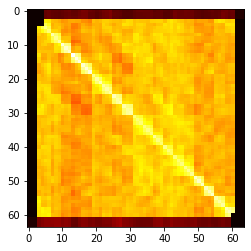

[[0.00045599 0.00045599 0.00045599 ... 0.00120036 0.00125479 0.00130185]
 [0.00045599 0.00045599 0.00045599 ... 0.00114575 0.00119161 0.00122705]
 [0.00045599 0.00045599 0.00045599 ... 0.00116756 0.00121514 0.00124265]
 ...
 [0.00105507 0.00103118 0.00103059 ... 0.00045599 0.00045599 0.00045599]
 [0.00109898 0.00106864 0.00106877 ... 0.00045599 0.00045599 0.00045599]
 [0.00115028 0.00111016 0.00110263 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


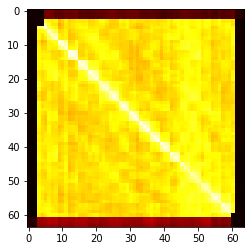

[[0.00045599 0.00045599 0.00045599 ... 0.00139314 0.00132768 0.00115377]
 [0.00045599 0.00045599 0.00045599 ... 0.00140399 0.00133196 0.00116014]
 [0.00045599 0.00045599 0.00045599 ... 0.00140456 0.00133345 0.00116723]
 ...
 [0.0011938  0.00119959 0.00118114 ... 0.00045599 0.00045599 0.00045599]
 [0.00114576 0.0011461  0.00112928 ... 0.00045599 0.00045599 0.00045599]
 [0.00107162 0.00107439 0.0010639  ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


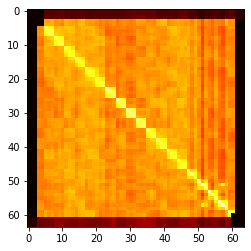

[[0.00045599 0.00045599 0.00045599 ... 0.00174058 0.0016638  0.00168129]
 [0.00045599 0.00045599 0.00045599 ... 0.00168929 0.00160423 0.00161828]
 [0.00045599 0.00045599 0.00045599 ... 0.00196117 0.00176793 0.00177994]
 ...
 [0.00149476 0.00145358 0.00160476 ... 0.00045599 0.00045599 0.00045599]
 [0.00138474 0.00133779 0.001402   ... 0.00045599 0.00045599 0.00045599]
 [0.00140284 0.00135293 0.0014151  ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


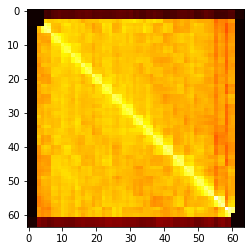

[[0.00045599 0.00045599 0.00045599 ... 0.00101373 0.00106024 0.00103076]
 [0.00045599 0.00045599 0.00045599 ... 0.0009587  0.001016   0.00098575]
 [0.00045599 0.00045599 0.00045599 ... 0.00102596 0.00108574 0.00105473]
 ...
 [0.00085308 0.00083835 0.00089463 ... 0.00045599 0.00045599 0.00045599]
 [0.00088263 0.0008789  0.00093658 ... 0.00045599 0.00045599 0.00045599]
 [0.00087696 0.00087149 0.00092985 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


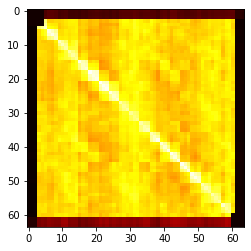

[[0.00045599 0.00045599 0.00045599 ... 0.00146676 0.00144509 0.00131034]
 [0.00045599 0.00045599 0.00045599 ... 0.00132597 0.00130455 0.0011919 ]
 [0.00045599 0.00045599 0.00045599 ... 0.00137865 0.00136162 0.00124974]
 ...
 [0.00126167 0.00114934 0.00119963 ... 0.00045599 0.00045599 0.00045599]
 [0.00123522 0.00112367 0.00117736 ... 0.00045599 0.00045599 0.00045599]
 [0.00118861 0.00108949 0.00114678 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


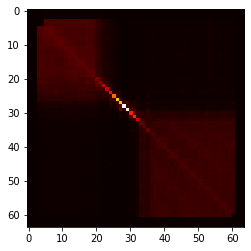

[[0.00045599 0.00045599 0.00045599 ... 0.00012932 0.00011865 0.00013092]
 [0.00045599 0.00045599 0.00045599 ... 0.00012222 0.00011263 0.00012386]
 [0.00045599 0.00045599 0.00045599 ... 0.0001135  0.00010652 0.00011514]
 ...
 [0.00013387 0.00012794 0.00011403 ... 0.00045599 0.00045599 0.00045599]
 [0.00012199 0.00011709 0.00010629 ... 0.00045599 0.00045599 0.00045599]
 [0.0001352  0.00012934 0.0001154  ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


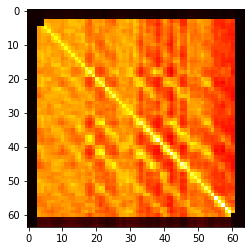

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.6381025e-05
  2.8555685e-05 2.4632907e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.7150185e-05
  2.9316079e-05 2.5285080e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 4.0106195e-05
  3.1165109e-05 2.7438668e-05]
 ...
 [3.6276215e-05 3.7703241e-05 4.0196715e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.8641231e-05 2.9927858e-05 3.1419539e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.5339821e-05 2.6474203e-05 2.8371540e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


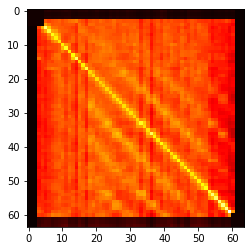

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 5.9695183e-05
  5.4793072e-05 4.9104619e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 4.2291624e-05
  3.7328206e-05 3.3579192e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.1879328e-05
  2.9464280e-05 3.1127009e-05]
 ...
 [5.3178264e-05 4.0453000e-05 2.9076939e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [4.7242891e-05 3.4558063e-05 2.6010652e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [4.5306271e-05 3.3266544e-05 2.9404780e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


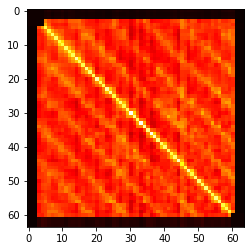

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.9182429e-05
  3.8150425e-05 3.2433967e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.2316573e-05
  3.1787953e-05 2.8249668e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.6613710e-05
  3.5557114e-05 3.1106771e-05]
 ...
 [4.0268926e-05 3.3995413e-05 3.8789931e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [3.6214591e-05 3.0886102e-05 3.4794233e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [3.1736890e-05 2.8293973e-05 3.1377316e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


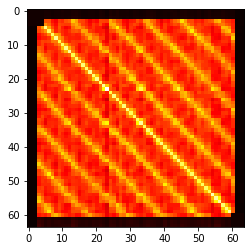

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.4354671e-05
  1.7721970e-05 2.2107319e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.4742332e-05
  1.7386274e-05 2.1145688e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.6940741e-05
  2.0152114e-05 2.6145386e-05]
 ...
 [1.4415961e-05 1.5297201e-05 1.6700782e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.6315140e-05 1.6537915e-05 1.8211826e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.1226379e-05 2.0977663e-05 2.4642739e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


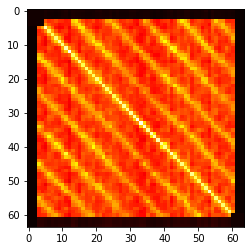

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.70400617e-05
  2.33589817e-05 2.73773712e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.34240054e-05
  1.80372062e-05 2.05345659e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.50189207e-05
  2.02052506e-05 2.39556448e-05]
 ...
 [1.59399024e-05 1.32723108e-05 1.39531585e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [2.08668625e-05 1.70303047e-05 1.79261424e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [2.50871417e-05 1.98881735e-05 2.18015139e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


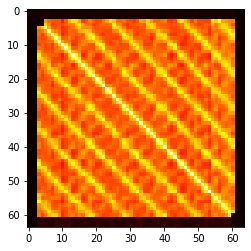

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.44829155e-05
  1.88806007e-05 2.31110771e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.55671787e-05
  1.91536728e-05 2.29238813e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.09063722e-05
  1.37732004e-05 1.62801844e-05]
 ...
 [1.36896324e-05 1.50682499e-05 1.04617075e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.72076452e-05 1.78761838e-05 1.27387539e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [2.16597236e-05 2.20007751e-05 1.54838344e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


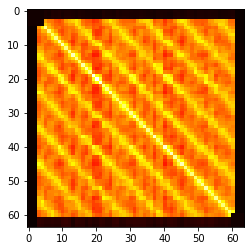

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.9990124e-05
  2.2685328e-05 2.1605347e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.8386696e-05
  2.0773847e-05 1.9676743e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.0159561e-05
  2.1939311e-05 2.1005111e-05]
 ...
 [1.8541929e-05 1.7830816e-05 1.8996107e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.0572397e-05 1.9696308e-05 2.0211890e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.0026715e-05 1.9069083e-05 1.9779602e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


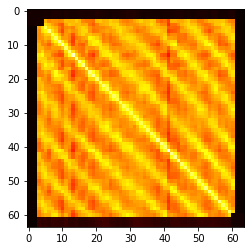

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.5791065e-05
  1.6351321e-05 1.7136821e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.7952294e-05
  1.8884308e-05 2.0233470e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.9646195e-05
  2.0629977e-05 2.1960181e-05]
 ...
 [1.4850043e-05 1.6997219e-05 1.7933920e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.5379368e-05 1.7882503e-05 1.8834968e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.6283137e-05 1.9356186e-05 2.0254625e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


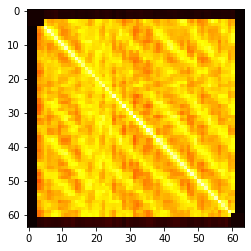

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.4650677e-05
  2.3160836e-05 2.7088554e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.0797466e-05
  1.9407789e-05 2.2254302e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.9249062e-05
  1.7715976e-05 2.0097723e-05]
 ...
 [2.2279386e-05 1.9290361e-05 1.7005479e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.0817490e-05 1.7902175e-05 1.5564823e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.4322229e-05 2.0506290e-05 1.7638811e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


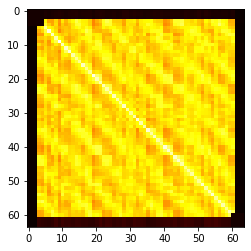

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.53476594e-05
  1.21594576e-05 1.13897495e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.82027379e-05
  1.44638652e-05 1.36802500e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.84570854e-05
  1.47788960e-05 1.40077318e-05]
 ...
 [1.40426700e-05 1.69894920e-05 1.66410373e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.11094942e-05 1.34803349e-05 1.33055210e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.04919318e-05 1.28549827e-05 1.27150734e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


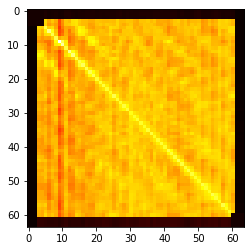

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.75062887e-05
  1.43226789e-05 1.42834888e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.91572035e-05
  1.55844136e-05 1.55959351e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 2.03285781e-05
  1.67170019e-05 1.65145248e-05]
 ...
 [1.66703176e-05 1.82841432e-05 1.92417683e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.34937063e-05 1.47160135e-05 1.56550177e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.35721184e-05 1.48531126e-05 1.55979524e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


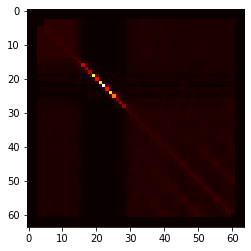

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.7002147e-05
  1.6694474e-05 1.2626624e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.8080449e-05
  1.7798186e-05 1.3586089e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.9991538e-05
  1.9762192e-05 1.5334303e-05]
 ...
 [1.7470351e-05 1.8549390e-05 2.0090652e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.6819011e-05 1.7903010e-05 1.9472103e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.2820795e-05 1.3773514e-05 1.5227960e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


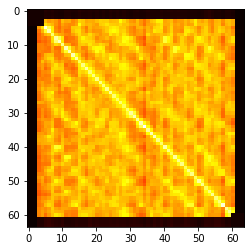

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.6958156e-05
  2.5039946e-05 2.8081093e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.4644043e-05
  2.2532582e-05 2.4692836e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.0799242e-05
  1.9047236e-05 2.0900532e-05]
 ...
 [2.3559664e-05 2.1900605e-05 1.8173805e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.1792916e-05 1.9941514e-05 1.6574228e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.4672167e-05 2.2061216e-05 1.8359888e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


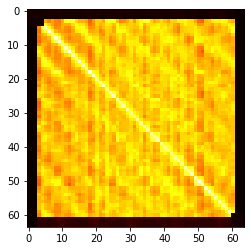

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.43587131e-05
  1.58469247e-05 1.64435332e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.38676260e-05
  1.56053284e-05 1.62241122e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.20156346e-05
  1.34630845e-05 1.40338670e-05]
 ...
 [1.26084460e-05 1.29497130e-05 1.07998703e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.38479591e-05 1.45019249e-05 1.20423465e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.47696364e-05 1.54969966e-05 1.29026175e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


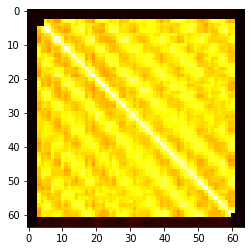

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.18499674e-05
  1.18367861e-05 1.24933886e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.08266295e-05
  1.11227027e-05 1.17398513e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.05618146e-05
  1.09159291e-05 1.14965469e-05]
 ...
 [1.02615304e-05 9.92979039e-06 9.73503757e-06 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.00243424e-05 9.97663756e-06 9.83981499e-06 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.05412273e-05 1.04912024e-05 1.03248194e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


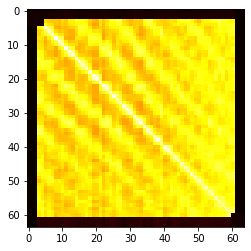

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 9.71443387e-06
  1.18712433e-05 1.29334394e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.01062624e-05
  1.23922810e-05 1.35241635e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 8.76973991e-06
  1.08636186e-05 1.17901873e-05]
 ...
 [9.19687409e-06 9.68184395e-06 8.32322803e-06 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.10241490e-05 1.16451438e-05 1.01135993e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.21149751e-05 1.28192805e-05 1.10716292e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


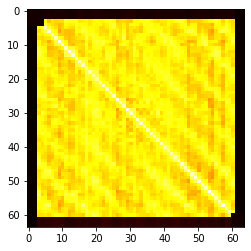

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.1421213e-05
  1.1276379e-05 1.0701328e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.4587764e-05
  1.4520475e-05 1.3933169e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.3241767e-05
  1.3328987e-05 1.2697581e-05]
 ...
 [1.1003843e-05 1.4189723e-05 1.2929133e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.0772515e-05 1.4004940e-05 1.2904343e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.0368380e-05 1.3629380e-05 1.2467675e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


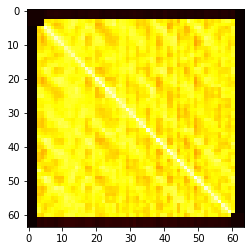

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 9.21233004e-06
  1.07654278e-05 1.11903028e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 9.36895412e-06
  1.05847430e-05 1.10715246e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.02123768e-05
  1.11745485e-05 1.17589825e-05]
 ...
 [8.98868620e-06 9.28849022e-06 9.77702348e-06 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.03593065e-05 1.03492048e-05 1.05507279e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.07719598e-05 1.08289805e-05 1.11064601e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


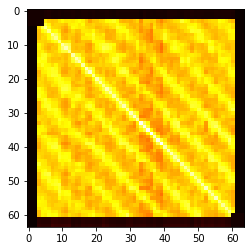

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.19842871e-05
  1.08139420e-05 1.20548066e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.19936694e-05
  1.11450518e-05 1.23022955e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.10261617e-05
  1.02258437e-05 1.11005875e-05]
 ...
 [1.17025538e-05 1.19887700e-05 1.08529739e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.03433795e-05 1.09122602e-05 9.85901625e-06 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.16938036e-05 1.22161919e-05 1.08541926e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


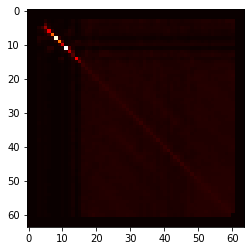

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.02258900e-05
  1.06113102e-05 1.22018319e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.01021642e-05
  1.04822620e-05 1.21815492e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 2.44733128e-05
  2.54929619e-05 2.98222621e-05]
 ...
 [8.83438497e-06 8.90926276e-06 2.00002978e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [9.02724332e-06 9.10318249e-06 2.05151609e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.05573135e-05 1.07592768e-05 2.44082948e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


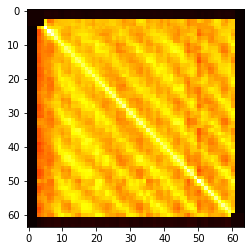

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.64430330e-05
  1.66452537e-05 1.69995674e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.44379746e-05
  1.45308277e-05 1.45086451e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.42453673e-05
  1.44105661e-05 1.47317069e-05]
 ...
 [1.48207009e-05 1.34489601e-05 1.26717641e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.48273211e-05 1.33769845e-05 1.26686382e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.54801910e-05 1.36540311e-05 1.32393943e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


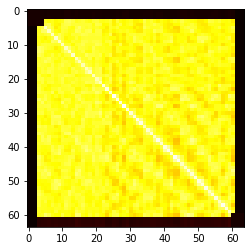

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.5918721e-06
  8.0078953e-06 7.5841240e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.7129549e-06
  8.0783175e-06 7.6017486e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.2014382e-06
  8.6452455e-06 7.9445590e-06]
 ...
 [6.5122622e-06 6.6667276e-06 7.0470301e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [7.8397488e-06 7.9502470e-06 8.3834911e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [7.4971290e-06 7.5540347e-06 7.7789891e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


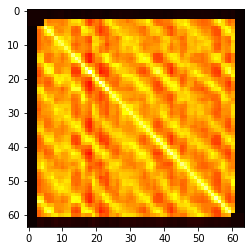

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 9.67461619e-06
  1.09593166e-05 8.74559919e-06]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 8.66037863e-06
  9.76346837e-06 7.61585852e-06]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 9.32434978e-06
  1.07074075e-05 8.46150488e-06]
 ...
 [9.31598606e-06 8.51248114e-06 8.95230733e-06 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.02687045e-05 9.33814226e-06 1.00031748e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [8.54954487e-06 7.59970044e-06 8.24750077e-06 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


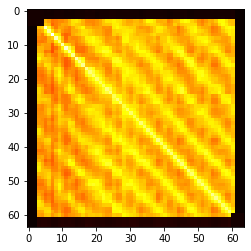

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.0396413e-06
  6.4979622e-06 8.3555806e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.9747985e-06
  6.4009660e-06 8.3457426e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 9.0242911e-06
  8.1856679e-06 1.0860103e-05]
 ...
 [6.7938586e-06 6.7786436e-06 8.5714028e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [6.2370150e-06 6.1871451e-06 7.7326185e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [8.1256649e-06 8.1732060e-06 1.0394154e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


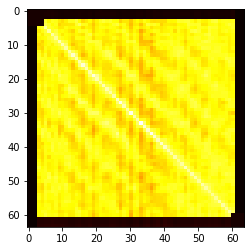

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.4900504e-06
  8.0469317e-06 7.6206729e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.2667972e-06
  7.7816512e-06 7.5365620e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.6663374e-06
  7.0809133e-06 6.7510641e-06]
 ...
 [6.9949688e-06 6.8200079e-06 6.1898922e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [7.4760624e-06 7.2653261e-06 6.5407362e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [7.0775714e-06 7.0340420e-06 6.2338727e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


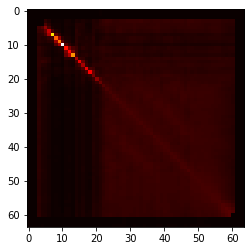

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.0440570e-05
  8.7651351e-06 1.0579670e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.1997268e-06
  6.9547914e-06 8.5893398e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.2642856e-06
  6.1945043e-06 7.4245991e-06]
 ...
 [1.0265616e-05 8.1811531e-06 6.9662369e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [8.4004969e-06 6.7637084e-06 5.7902516e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.0483574e-05 8.6367709e-06 7.1755430e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


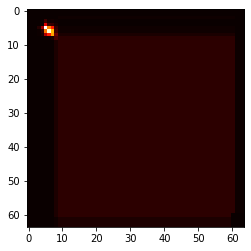

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.42315685e-05
  1.42315685e-05 1.42315685e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.46706798e-05
  1.46706798e-05 1.46706798e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 4.23068414e-05
  4.23068414e-05 4.23068414e-05]
 ...
 [3.58302123e-06 4.07275274e-06 1.00400757e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [3.58302123e-06 4.07275274e-06 1.00400757e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [3.58302123e-06 4.07275274e-06 1.00400757e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


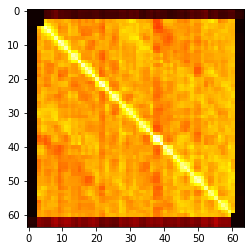

[[0.00045599 0.00045599 0.00045599 ... 0.00155913 0.0016078  0.0012807 ]
 [0.00045599 0.00045599 0.00045599 ... 0.00177086 0.00182069 0.00145621]
 [0.00045599 0.00045599 0.00045599 ... 0.00170221 0.00174935 0.00140589]
 ...
 [0.00125513 0.00146418 0.00142144 ... 0.00045599 0.00045599 0.00045599]
 [0.00127175 0.00147915 0.00143536 ... 0.00045599 0.00045599 0.00045599]
 [0.00107011 0.00124971 0.00121855 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


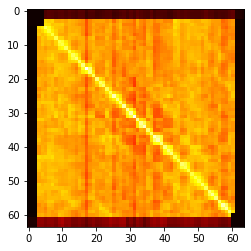

[[0.00045599 0.00045599 0.00045599 ... 0.00130035 0.001286   0.00103277]
 [0.00045599 0.00045599 0.00045599 ... 0.00131312 0.00127755 0.00100001]
 [0.00045599 0.00045599 0.00045599 ... 0.00136687 0.00132665 0.00105579]
 ...
 [0.00107919 0.00109823 0.00114479 ... 0.00045599 0.00045599 0.00045599]
 [0.00107452 0.00107574 0.00111865 ... 0.00045599 0.00045599 0.00045599]
 [0.00093186 0.0009093  0.00096136 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


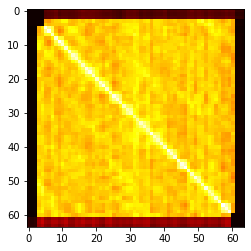

[[0.00045599 0.00045599 0.00045599 ... 0.00180501 0.00181937 0.00172317]
 [0.00045599 0.00045599 0.00045599 ... 0.00143238 0.00146373 0.0013576 ]
 [0.00045599 0.00045599 0.00045599 ... 0.00177    0.00177456 0.00161743]
 ...
 [0.00154694 0.00123229 0.00151164 ... 0.00045599 0.00045599 0.00045599]
 [0.00148338 0.00119798 0.00144179 ... 0.00045599 0.00045599 0.00045599]
 [0.00157212 0.00124334 0.00147049 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


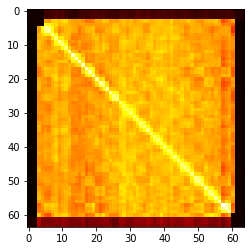

[[0.00045599 0.00045599 0.00045599 ... 0.00107422 0.00118533 0.00098224]
 [0.00045599 0.00045599 0.00045599 ... 0.00114683 0.00126368 0.00102536]
 [0.00045599 0.00045599 0.00045599 ... 0.00129587 0.00141177 0.00114313]
 ...
 [0.00087726 0.00097044 0.00109927 ... 0.00045599 0.00045599 0.00045599]
 [0.00095051 0.00104999 0.00117595 ... 0.00045599 0.00045599 0.00045599]
 [0.00088099 0.00095293 0.00106501 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


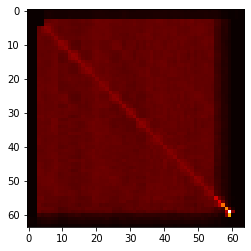

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.3875731e-04
  3.8850444e-04 4.7991281e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.2123692e-04
  2.9910469e-04 3.6330213e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 5.5973697e-04
  2.6250162e-04 3.1388998e-05]
 ...
 [1.2332263e-03 1.1161258e-03 9.9077018e-04 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [6.9415447e-04 5.7517283e-04 4.9732474e-04 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.1698145e-04 9.5309813e-05 8.1129729e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


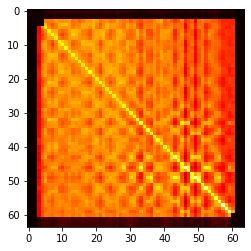

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.1724496e-05
  2.3683002e-05 2.0056306e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.3303037e-05
  3.9313425e-05 3.1520431e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.3956723e-05
  4.1742198e-05 3.5780038e-05]
 ...
 [1.7154474e-05 2.9396235e-05 2.9090301e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.8172104e-05 3.3720153e-05 3.4748700e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.6488579e-05 2.8967072e-05 3.1913016e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


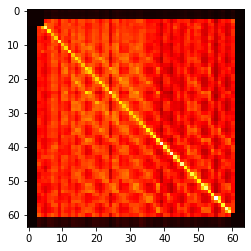

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 4.1084862e-05
  4.1317788e-05 3.2928911e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.1539348e-05
  3.0335286e-05 2.6278880e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.1549287e-05
  3.0606334e-05 2.5282430e-05]
 ...
 [3.2439195e-05 2.7044369e-05 2.7437738e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [3.2503765e-05 2.5916757e-05 2.6520300e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.7180549e-05 2.3557199e-05 2.2986360e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


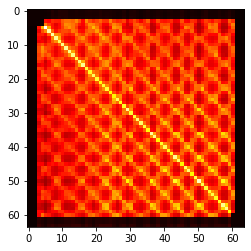

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.3658973e-05
  1.9691664e-05 1.9727999e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.5817744e-05
  2.1435244e-05 2.2966657e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 4.5295583e-05
  4.0708743e-05 4.1164963e-05]
 ...
 [2.2490991e-05 2.6395182e-05 4.2490945e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.8160092e-05 2.1259724e-05 3.7046833e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.9456271e-05 2.4359477e-05 4.0061954e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


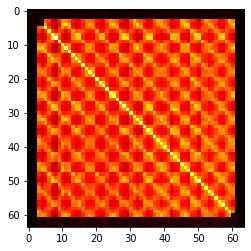

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.4190569e-05
  1.7595439e-05 1.9753899e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.4549114e-05
  1.9443372e-05 2.2297803e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.4157100e-05
  1.9420590e-05 2.1148669e-05]
 ...
 [2.2900491e-05 2.3517432e-05 2.2671822e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.6026679e-05 1.7921337e-05 1.7536735e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.8669351e-05 2.1325235e-05 1.9815376e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


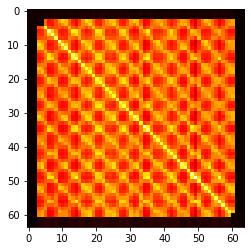

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.2488264e-05
  1.9684343e-05 2.0561742e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.5473848e-05
  2.3622744e-05 2.4272058e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.7058888e-05
  2.2044482e-05 2.2553440e-05]
 ...
 [2.0019283e-05 2.3414379e-05 2.3773327e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.6979990e-05 2.1039838e-05 1.8767390e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.7778244e-05 2.1668611e-05 1.9245499e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


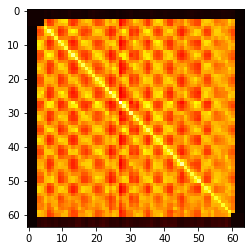

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.3860578e-05
  1.5533284e-05 1.7002949e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.5487105e-05
  1.6583925e-05 1.7970737e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.5332100e-05
  1.5914424e-05 1.7286347e-05]
 ...
 [1.3309687e-05 1.5267333e-05 1.4462831e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.4193983e-05 1.5557318e-05 1.4285553e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.6283391e-05 1.7668224e-05 1.6262566e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


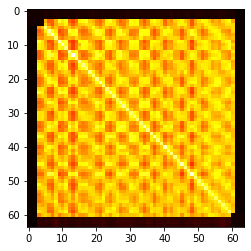

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.44560754e-05
  1.57045706e-05 1.51388876e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.72837972e-05
  1.86636444e-05 1.79746894e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.75521400e-05
  1.87911410e-05 1.86855450e-05]
 ...
 [1.26486430e-05 1.55358575e-05 1.47605133e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.37232255e-05 1.67544076e-05 1.57819650e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.35641749e-05 1.65448655e-05 1.60909985e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


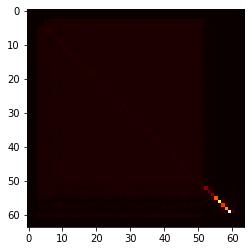

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.4245535e-05
  4.3775650e-05 4.0172592e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.3912995e-05
  4.4151169e-05 4.0232655e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.3563809e-05
  4.1543695e-05 4.1050142e-05]
 ...
 [3.7627415e-05 3.7180565e-05 3.5992914e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [7.7547411e-05 7.8358549e-05 7.2433402e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [6.0151691e-05 6.0354014e-05 6.0496695e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


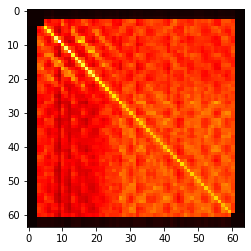

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.9681689e-05
  1.8998588e-05 2.4774434e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.7481994e-05
  1.7101307e-05 2.2065236e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.2979111e-05
  2.2555125e-05 2.8984978e-05]
 ...
 [1.7861805e-05 1.6410009e-05 2.1690194e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.6977490e-05 1.5806527e-05 2.0963544e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.2733551e-05 2.0942431e-05 2.7663289e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


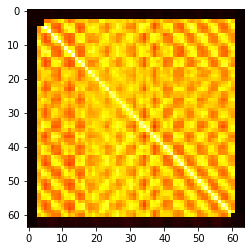

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.70427138e-05
  1.55644157e-05 1.27619805e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.76091871e-05
  1.67518756e-05 1.40735983e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.49420321e-05
  1.40478551e-05 1.21005651e-05]
 ...
 [1.56967617e-05 1.70775857e-05 1.41096161e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.40216562e-05 1.58908006e-05 1.29750988e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.18049875e-05 1.37078223e-05 1.14759141e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


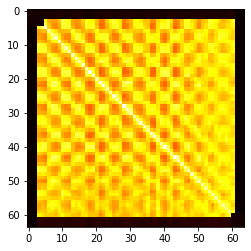

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.1791600e-05
  8.6776154e-06 9.0596277e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.3455375e-05
  9.7971288e-06 1.0126792e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.4843671e-05
  1.0749013e-05 1.1172260e-05]
 ...
 [1.1049911e-05 1.3053273e-05 1.4272931e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [8.1559256e-06 9.5325522e-06 1.0366382e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [8.6858618e-06 1.0051062e-05 1.0990801e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


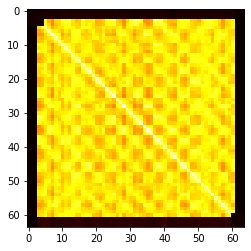

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.31852548e-05
  1.32294781e-05 1.58090188e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.23390109e-05
  1.27024114e-05 1.51910135e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.06581256e-05
  1.07788865e-05 1.30101043e-05]
 ...
 [1.25948109e-05 1.19079014e-05 1.02014274e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.25366178e-05 1.21611774e-05 1.02350168e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.52931643e-05 1.48467352e-05 1.26110208e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


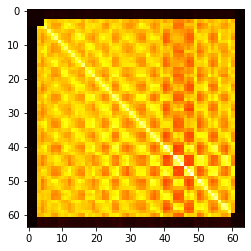

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.28408374e-05
  1.15781604e-05 1.13451697e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.57950672e-05
  1.44406004e-05 1.43103880e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.31587594e-05
  1.19791985e-05 1.18841281e-05]
 ...
 [1.27517487e-05 1.53470955e-05 1.29661539e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.14993290e-05 1.40328711e-05 1.18053958e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.14897875e-05 1.41801474e-05 1.19423048e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


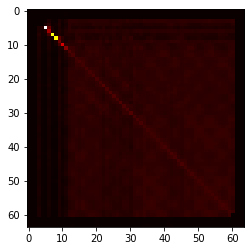

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.7794576e-05
  3.2026714e-05 3.9177765e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 9.7183554e-05
  9.8529163e-05 1.2380515e-04]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.3756984e-05
  3.7224261e-05 4.4139317e-05]
 ...
 [1.6424106e-05 6.1792634e-05 1.9716879e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.8306340e-05 6.0600505e-05 2.1031401e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.2910099e-05 7.7901946e-05 2.5513253e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


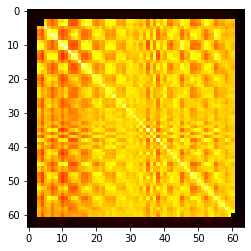

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 8.56247880e-06
  8.04922183e-06 7.79083712e-06]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 8.89385137e-06
  8.30518275e-06 8.06064418e-06]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.04732235e-05
  9.85781389e-06 9.71401096e-06]
 ...
 [7.87934368e-06 8.11672453e-06 9.09979917e-06 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [7.29509566e-06 7.46494652e-06 8.43565067e-06 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [7.17941612e-06 7.36673701e-06 8.45209706e-06 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


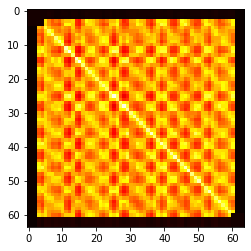

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 9.2397449e-06
  7.9441679e-06 8.3719287e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.3051864e-06
  7.1440018e-06 7.4339373e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.3315490e-06
  7.0859069e-06 7.2937141e-06]
 ...
 [9.1165002e-06 8.1660810e-06 7.9766251e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [7.7038621e-06 6.9039525e-06 6.6677731e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [8.3043205e-06 7.3484130e-06 7.0202486e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


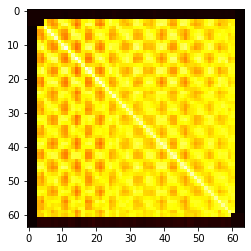

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.1569920e-05
  1.0642256e-05 1.0714937e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 6.5122376e-06
  6.1183759e-06 6.2134159e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.8975199e-06
  7.2747525e-06 7.3667752e-06]
 ...
 [1.0656236e-05 5.9843369e-06 7.1721834e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [9.6957829e-06 5.5615737e-06 6.5351364e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [9.8366554e-06 5.6911576e-06 6.6684133e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


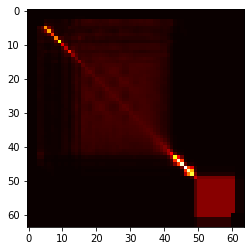

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.7254642e-05
  3.7254642e-05 3.7254642e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.6281617e-05
  3.6281617e-05 3.6281617e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.5703390e-05
  2.5703390e-05 2.5703390e-05]
 ...
 [2.0704123e-05 2.0970145e-05 1.1798925e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.0704123e-05 2.0970145e-05 1.1798925e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.0704123e-05 2.0970145e-05 1.1798925e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


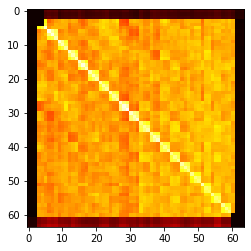

[[0.00045599 0.00045599 0.00045599 ... 0.00137992 0.00139918 0.00156671]
 [0.00045599 0.00045599 0.00045599 ... 0.00119783 0.00122169 0.00138502]
 [0.00045599 0.00045599 0.00045599 ... 0.00130794 0.0013354  0.00149548]
 ...
 [0.0012026  0.00103996 0.00113071 ... 0.00045599 0.00045599 0.00045599]
 [0.00123283 0.00107238 0.00116719 ... 0.00045599 0.00045599 0.00045599]
 [0.00135442 0.00119282 0.00128246 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


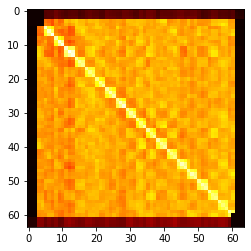

[[0.00045599 0.00045599 0.00045599 ... 0.00137478 0.0012666  0.0013614 ]
 [0.00045599 0.00045599 0.00045599 ... 0.00152079 0.00137049 0.00148091]
 [0.00045599 0.00045599 0.00045599 ... 0.00168523 0.00152984 0.00161827]
 ...
 [0.00126016 0.00138485 0.00149082 ... 0.00045599 0.00045599 0.00045599]
 [0.00111388 0.00119734 0.00129843 ... 0.00045599 0.00045599 0.00045599]
 [0.00119141 0.00128749 0.00136678 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


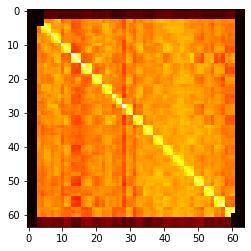

[[0.00045599 0.00045599 0.00045599 ... 0.00144317 0.00152567 0.00154185]
 [0.00045599 0.00045599 0.00045599 ... 0.00115313 0.00123918 0.0012773 ]
 [0.00045599 0.00045599 0.00045599 ... 0.00105978 0.00115205 0.00116889]
 ...
 [0.00112278 0.00098731 0.00090952 ... 0.00045599 0.00045599 0.00045599]
 [0.00114946 0.00102746 0.00095747 ... 0.00045599 0.00045599 0.00045599]
 [0.0011639  0.00106113 0.00097335 ... 0.00045599 0.00045599 0.00045599]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


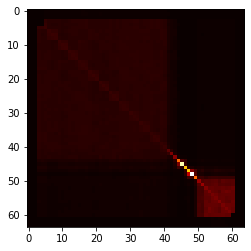

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 9.67372762e-05
  1.11523477e-04 9.23453044e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 8.61683729e-05
  9.97508905e-05 8.13229708e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 8.50796132e-05
  9.85554434e-05 8.05902600e-05]
 ...
 [1.12244525e-04 1.02725317e-04 1.00209982e-04 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.28135856e-04 1.17755037e-04 1.14947412e-04 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.09595836e-04 9.91632623e-05 9.70903275e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


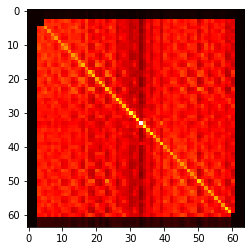

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.0691787e-05
  2.5180352e-05 1.6380121e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.7034899e-05
  3.3275512e-05 2.1762902e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.3797729e-05
  3.0104702e-05 1.9254112e-05]
 ...
 [2.1392907e-05 2.8741273e-05 2.4817933e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.5480282e-05 3.4623947e-05 3.0728053e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.7219170e-05 2.3524550e-05 2.0416293e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


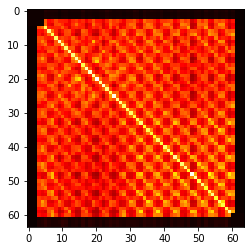

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 3.0487283e-05
  4.3964617e-05 3.8765280e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.0058853e-05
  2.8245760e-05 2.4074961e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.3610539e-05
  3.4266195e-05 2.9821113e-05]
 ...
 [2.6720902e-05 1.8242068e-05 2.1398995e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [3.7134552e-05 2.4755047e-05 2.9929251e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [3.4394750e-05 2.2164117e-05 2.7360758e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


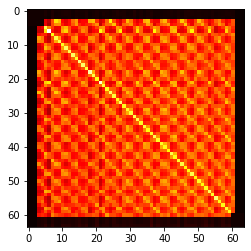

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.6853239e-05
  1.6210353e-05 2.2645121e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.9490550e-05
  1.8490664e-05 2.7052825e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.2656304e-05
  2.1020505e-05 2.7320928e-05]
 ...
 [1.4940921e-05 1.7410794e-05 1.8589119e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.4203842e-05 1.6325495e-05 1.7046381e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.0710007e-05 2.4929795e-05 2.3124734e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


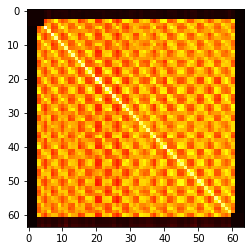

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.7673435e-05
  2.3639483e-05 2.6300570e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.3066779e-05
  1.8628101e-05 2.0911366e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.2905115e-05
  1.8134218e-05 2.1536394e-05]
 ...
 [2.4381441e-05 2.1202184e-05 2.0502919e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.9907617e-05 1.6366175e-05 1.5515545e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [2.2210248e-05 1.8423323e-05 1.8477713e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


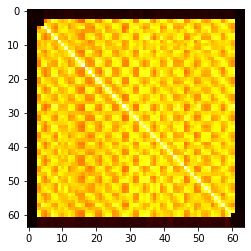

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.8545999e-05
  1.8291359e-05 1.6959806e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.5287689e-05
  1.4043886e-05 1.3029772e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.5991724e-05
  1.4931592e-05 1.3784425e-05]
 ...
 [1.5538692e-05 1.3849228e-05 1.4196554e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.5136004e-05 1.2565276e-05 1.3091663e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.3976792e-05 1.1610286e-05 1.2036458e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


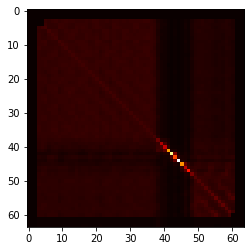

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.55263479e-05
  1.19809656e-05 1.53098372e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.61980442e-05
  1.23740265e-05 1.56261613e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.64170560e-05
  1.25524730e-05 1.58250459e-05]
 ...
 [1.64629473e-05 1.77043421e-05 1.78270220e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.22861939e-05 1.30802327e-05 1.31825709e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.62954693e-05 1.71446063e-05 1.72498985e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


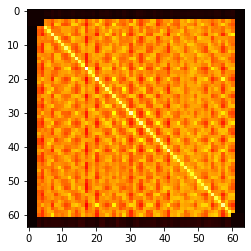

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.46265920e-05
  1.46518896e-05 1.24149783e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.65112178e-05
  1.80472798e-05 1.52209032e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.44969254e-05
  1.49078487e-05 1.26549867e-05]
 ...
 [1.40147249e-05 1.59834162e-05 1.34666398e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.32285022e-05 1.64618195e-05 1.30488997e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.12795333e-05 1.39712292e-05 1.11467625e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


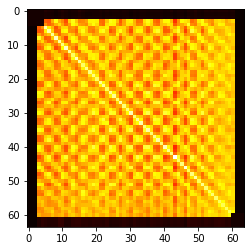

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.90181636e-05
  1.42033332e-05 1.23921136e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.38248206e-05
  1.02573067e-05 9.11362895e-06]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.66554837e-05
  1.24014205e-05 1.07869191e-05]
 ...
 [1.58273542e-05 1.15006624e-05 1.32436344e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.17868403e-05 8.50871766e-06 9.83306199e-06 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.03784714e-05 7.62962100e-06 8.63168589e-06 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


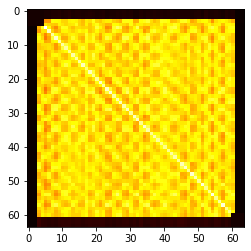

[[4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.46968960e-05
  1.47808942e-05 1.32871028e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.62116048e-05
  1.61999669e-05 1.45989698e-05]
 [4.55986708e-04 4.55986708e-04 4.55986708e-04 ... 1.45410577e-05
  1.46880275e-05 1.24903181e-05]
 ...
 [1.32091618e-05 1.49577527e-05 1.28889915e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.30954622e-05 1.47341452e-05 1.28338479e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]
 [1.20288787e-05 1.35677474e-05 1.11517156e-05 ... 4.55986708e-04
  4.55986708e-04 4.55986708e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


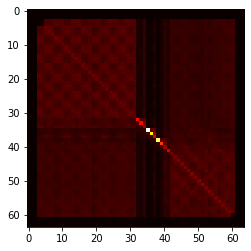

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.5048232e-06
  1.0406671e-05 7.3097567e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 8.3776868e-06
  1.0377720e-05 7.5344660e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 9.7458242e-06
  1.1894655e-05 8.3051218e-06]
 ...
 [8.4413787e-06 8.1918461e-06 9.3746557e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.0097107e-05 9.9196568e-06 1.1184732e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [7.4180439e-06 7.5326620e-06 8.1681010e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


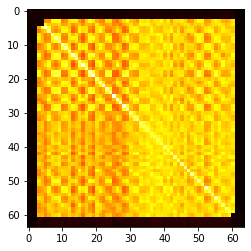

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.1772000e-05
  1.0927347e-05 9.9217477e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 1.2042532e-05
  1.1216355e-05 1.0451743e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 9.7128614e-06
  9.2222381e-06 8.4219573e-06]
 ...
 [9.7779021e-06 1.1011345e-05 8.5413221e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [8.9925361e-06 1.0161231e-05 8.0350073e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [8.3222512e-06 9.6509157e-06 7.4790805e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


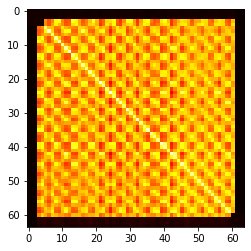

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 9.8509736e-06
  1.0539766e-05 9.3774725e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.0075412e-06
  7.5052576e-06 6.3299954e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 9.5188070e-06
  1.0155732e-05 8.1469934e-06]
 ...
 [8.9545583e-06 6.6225293e-06 8.6339969e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [9.3790859e-06 6.9436592e-06 9.0178955e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [8.8364759e-06 6.2014024e-06 7.6604638e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


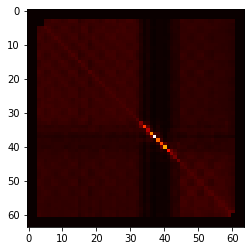

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 9.3036861e-06
  9.8256851e-06 7.4741606e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.2669704e-06
  7.7370296e-06 5.8449073e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 7.2384669e-06
  7.6122415e-06 5.6944755e-06]
 ...
 [9.9235685e-06 7.9711053e-06 7.6674696e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [9.6107715e-06 7.7825507e-06 7.3943597e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [7.6405704e-06 6.1445953e-06 5.7810894e-06 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
4096


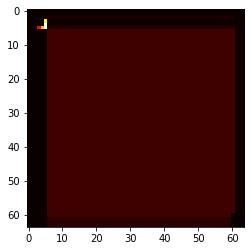

[[4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 4.4670069e-06
  4.4670069e-06 4.4670069e-06]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.0917832e-05
  2.0917832e-05 2.0917832e-05]
 [4.5598671e-04 4.5598671e-04 4.5598671e-04 ... 2.3383414e-04
  2.3383414e-04 2.3383414e-04]
 ...
 [1.0585735e-06 6.1121773e-06 7.8849698e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.0585735e-06 6.1121773e-06 7.8849698e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]
 [1.0585735e-06 6.1121773e-06 7.8849698e-05 ... 4.5598671e-04
  4.5598671e-04 4.5598671e-04]]
True
batch_size:  tf.Tensor(1, shape=(), dtype=int32)
num_frames:  64
len(x_np)/batch_size: tf.Tensor(64.0, shape=(), dtype=float64)
Visualizing results...


In [6]:
print('Running RepNet...') 
(pred_period, pred_score, within_period,
 per_frame_counts, chosen_stride) = get_counts(
     model,
     imgs,
     strides=[1,2,3,4],
     batch_size=1,
     threshold=THRESHOLD,
     within_period_threshold=WITHIN_PERIOD_THRESHOLD,
     constant_speed=CONSTANT_SPEED,
     median_filter=MEDIAN_FILTER,
     fully_periodic=FULLY_PERIODIC)
print('Visualizing results...') 
viz_reps(imgs, per_frame_counts, pred_score, interval=1000/VIZ_FPS,
         plot_score=PLOT_SCORE)


In [7]:
# Debugging video showing scores, per-frame frequency prediction and 
# within_period scores.
create_count_video(imgs,
                   per_frame_counts,
                   within_period,
                   score=pred_score,
                   fps=vid_fps,
                   output_file='/tmp/debug_video.mp4',
                   delay=1000/VIZ_FPS,
                   plot_count=True,
                   plot_within_period=True,
                   plot_score=True)
show_video('/tmp/debug_video.mp4')


# Citation

If you found our paper/code useful in your research, consider citing our paper:


```
@InProceedings{Dwibedi_2020_CVPR,
author = {Dwibedi, Debidatta and Aytar, Yusuf and Tompson, Jonathan and Sermanet, Pierre and Zisserman, Andrew},
title = {Counting Out Time: Class Agnostic Video Repetition Counting in the Wild},
booktitle = {IEEE/CVF Conference on Computer Vision and Pattern Recognition (CVPR)},
month = {June},
year = {2020}
}
```



